# Objective

This notebook investigates the circularity of vertical and bird's eye view amphora sections.

# Dataset

50 Yassiada amphoras. See "Amphoras in Dataset" for full list.

For each amphora, four image captures with orientations:
- 0 degrees from front (with handles on either side)
- 45 degrees from front
- 90 degrees from front (facing a handle attachment points)
- bird's eye view

# Contents

1. Calculating and visualizing circularity for each amphora in the dataset
    - Top row: the amphora snapshot
    - Bottom row: binarized and flooded amphora silhouette with an ideal circle superimposed
2. Visualizations of circularity distributions for orientations ({0, 45, 90} degrees from front and bird's-eye)
    - Plots for the four orientations displayed separately
    - Superimposing the plots for the four orientations
    - Stacking the plots for the four orientations
3. Discussion of results

# Notes

The backend code for the circularity analysis in this notebook lives in a Python file (`circularity_util.py`). This notebook imports methods from that file, which contains ~200 lines of code that would otherwise clutter this notebook.

In [87]:
import circularity_util
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.lines import Line2D
import numpy as np
import pandas as pd
from skimage.io import imread

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load amphora labels

In [2]:
df = pd.read_csv('models.csv', delimiter=',')
models = list(df.model)

In [3]:
print('\nAmphoras in Dataset:\n')
for i in range(int(len(models)/5)):
    print('%s\t%s\t%s\t%s\t%s' % (models[i*5], models[i*5+1], models[i*5+2], models[i*5+3], models[i*5+4]))
print('\n')


Amphoras in Dataset:

83-2	84-1	84-3	84-10	86-38
86-75	86-85	86-90	86-92	86-93
86-95	86-96	86-99	86-100	86-113
C	D	F	UN16	W1
W8	W43	W55	W63	W69
W70	W74	W77	X5	X12
Y2	Y7	Y11	Y12	Y14
Y15	Y22	Y28	Y32	Y34
Y39	Y45	Y114	Y123	Y126
Y127	Y128	Y135	Y148	Y149




# Calculate circularity

Visualizations for each amphora in the dataset:
- Top row: the amphora snapshot
- Bottom row: binarized and flooded amphora silhouette with an ideal circle superimposed

Model: 83-2



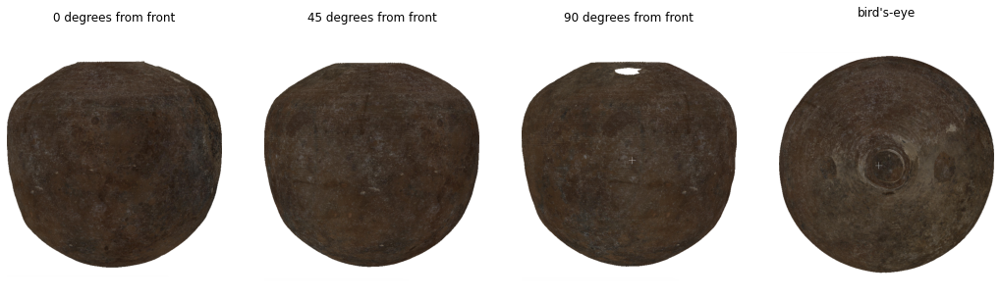

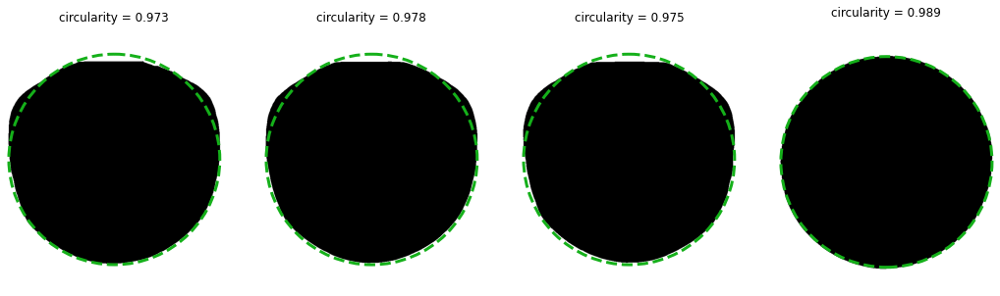

Model: 84-1



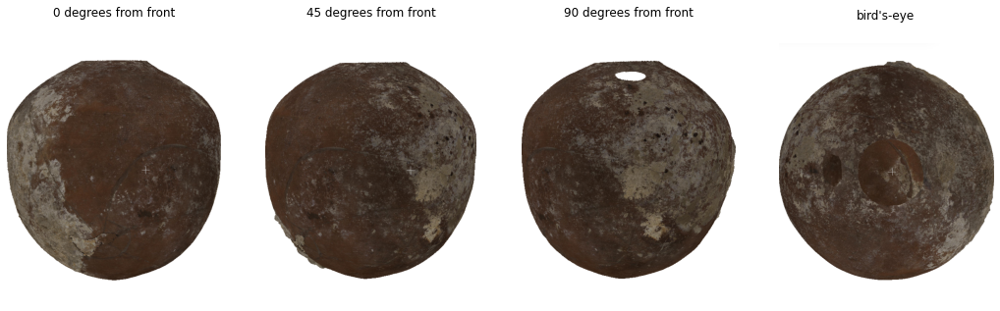

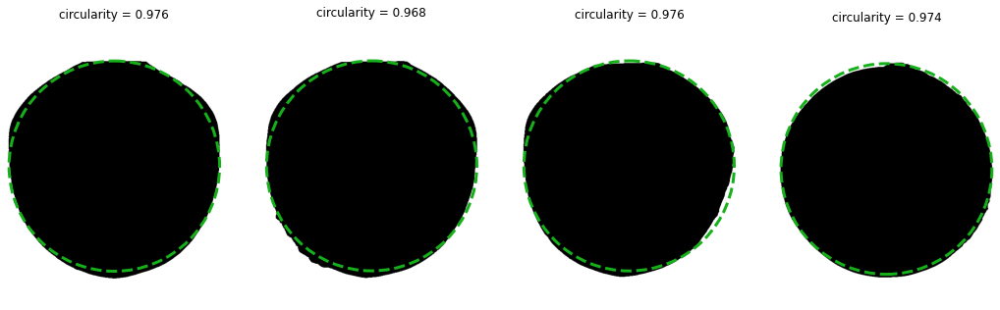

Model: 84-3



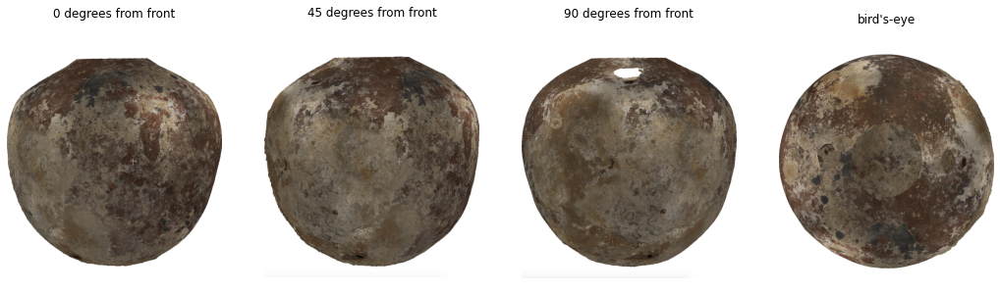

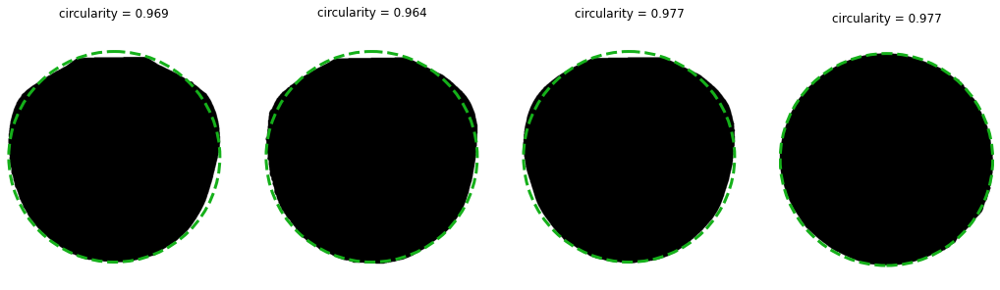

Model: 84-10



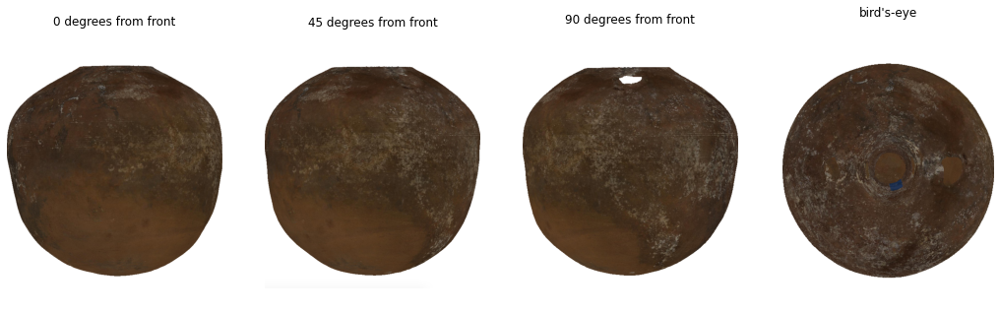

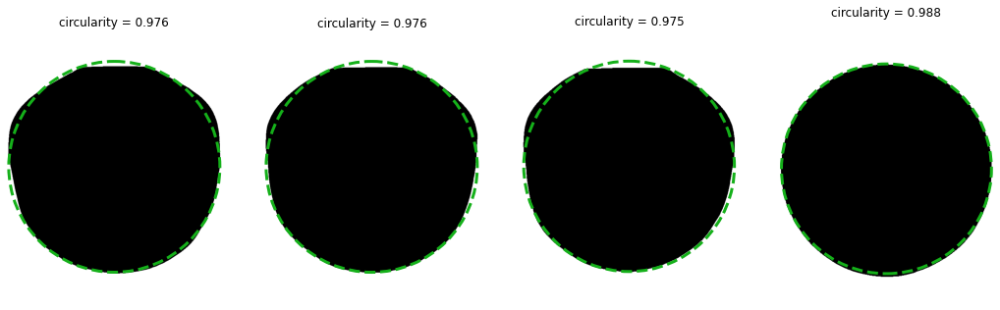

Model: 86-38



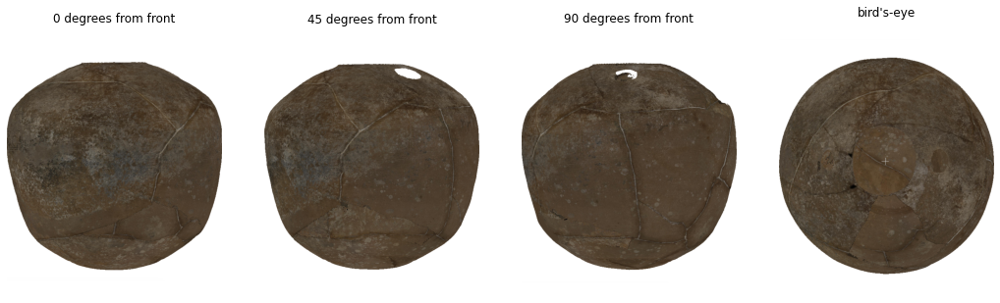

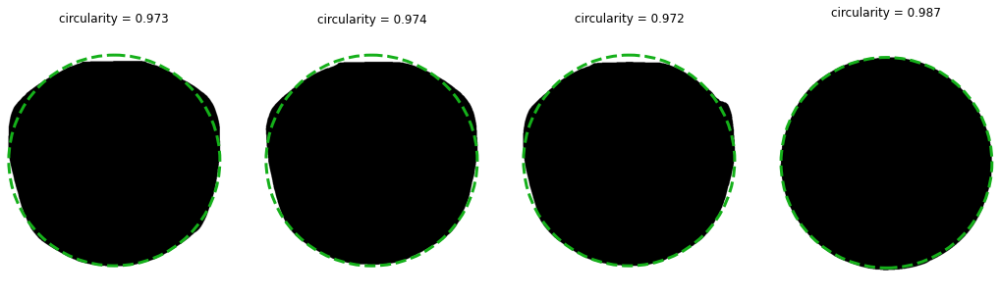

Model: 86-75



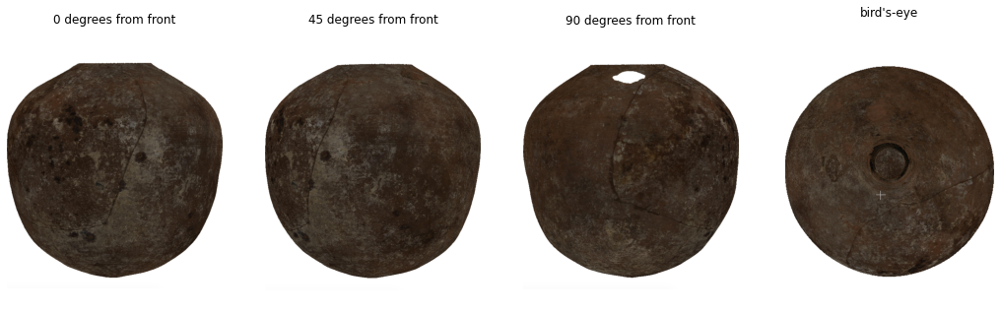

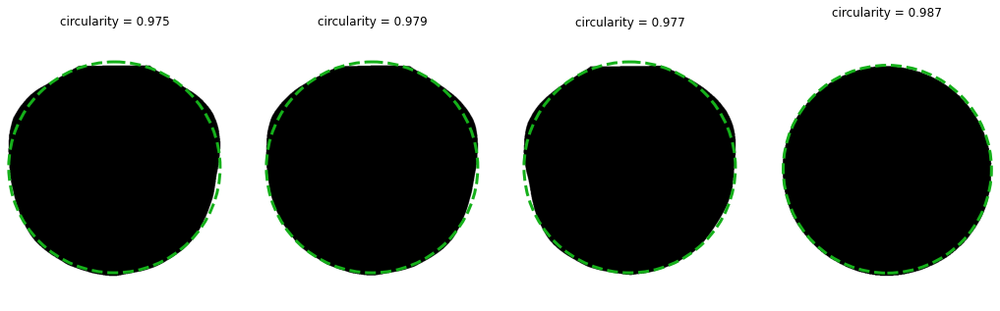

Model: 86-85



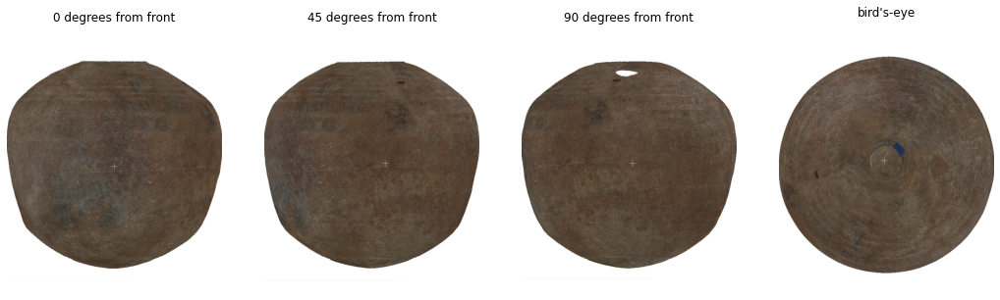

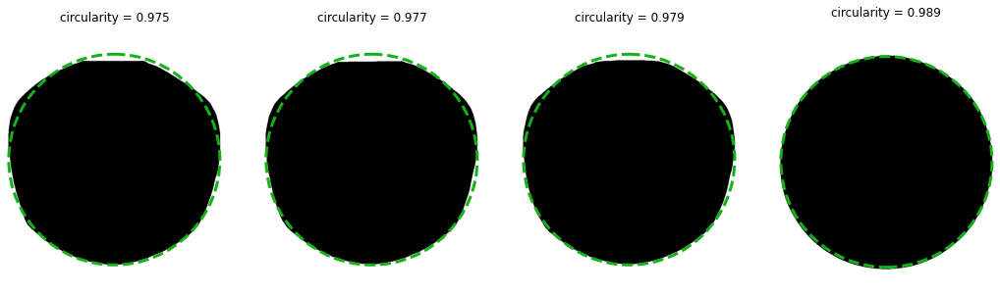

Model: 86-90



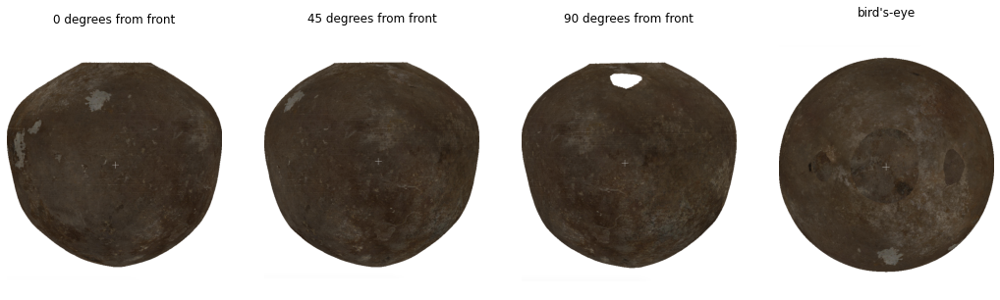

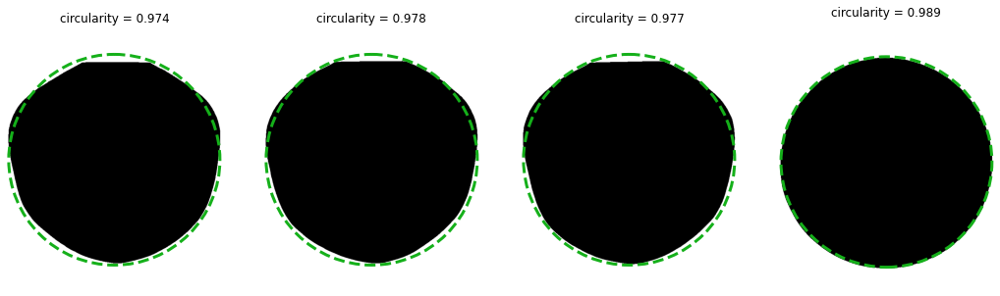

Model: 86-92



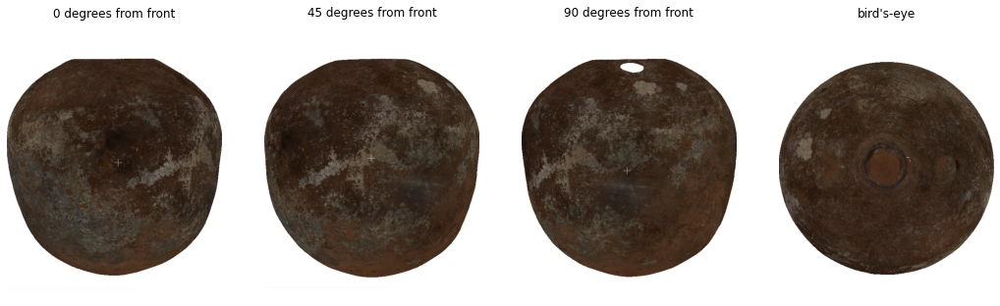

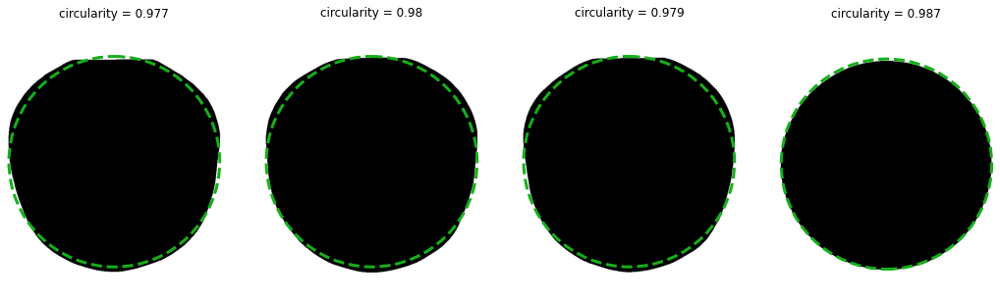

Model: 86-93



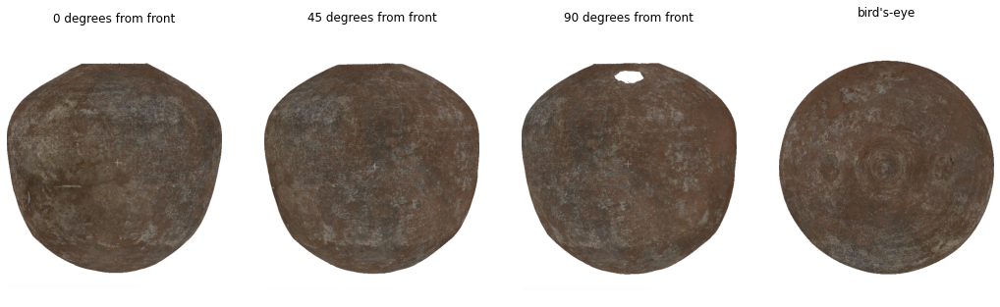

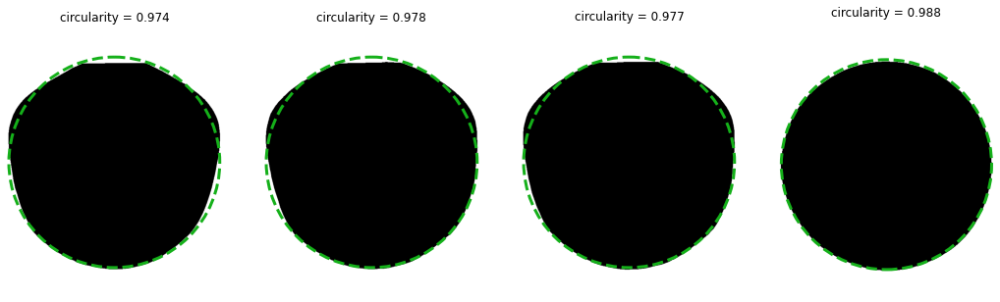

Model: 86-95



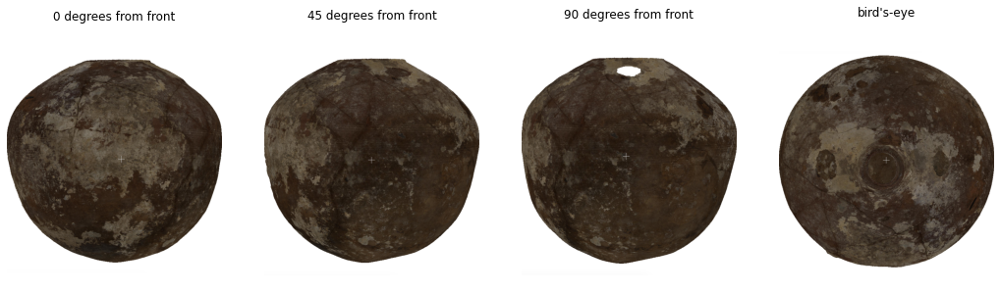

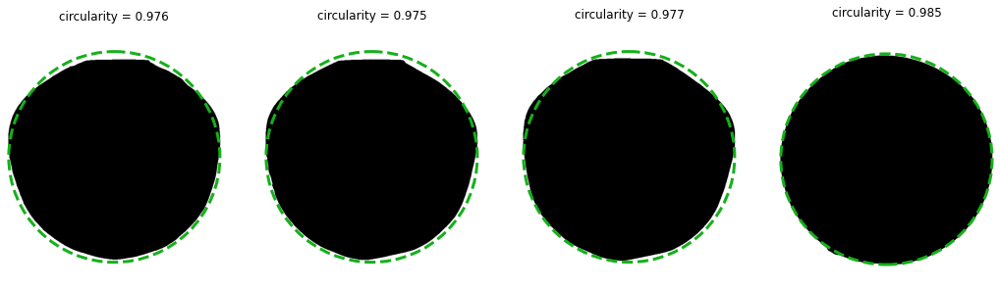

Model: 86-96



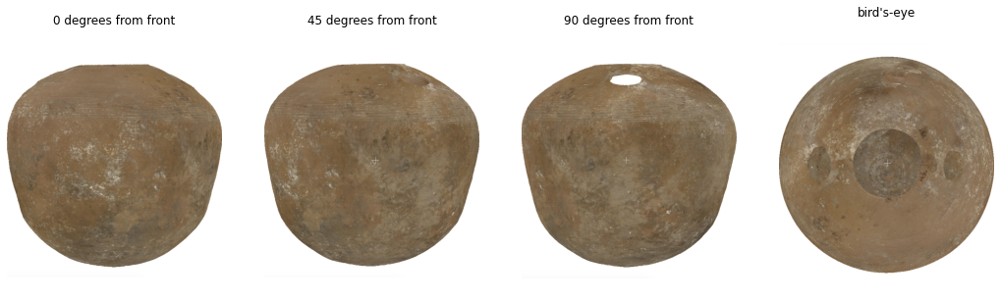

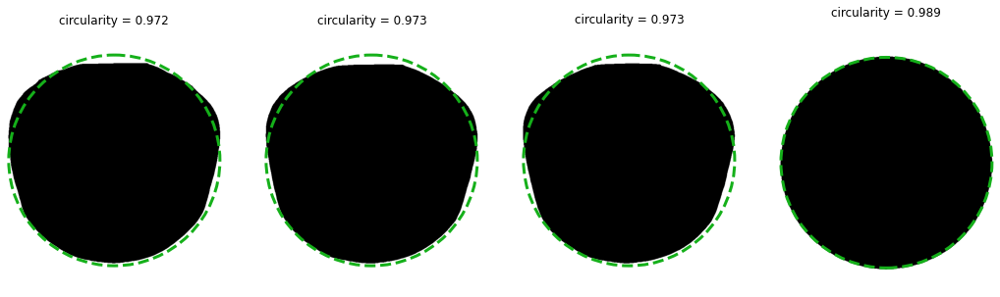

Model: 86-99



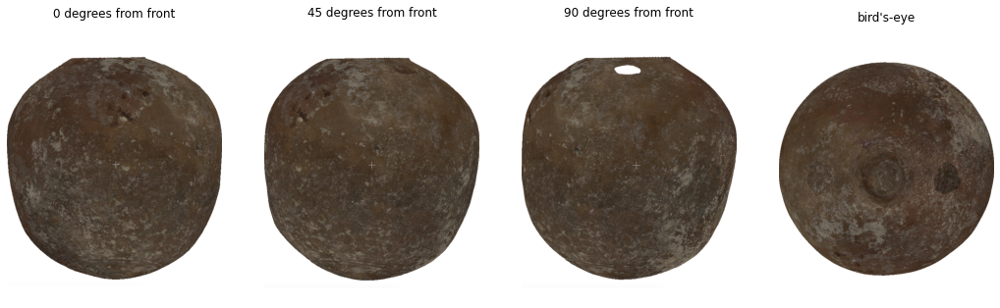

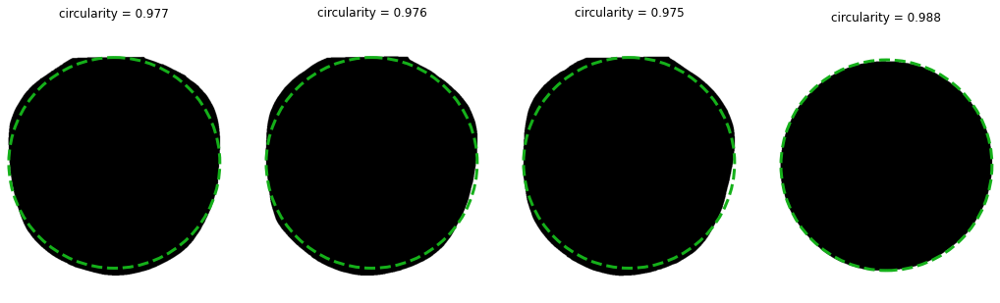

Model: 86-100



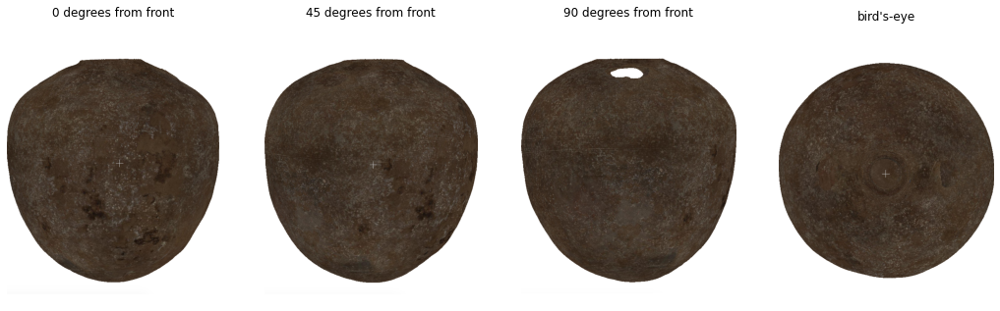

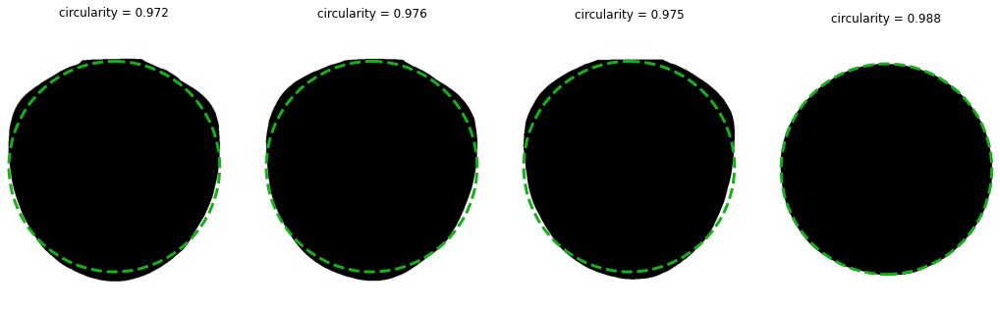

Model: 86-113



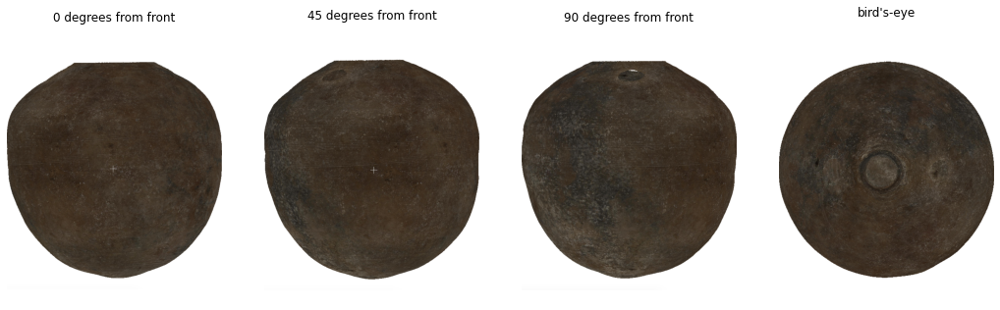

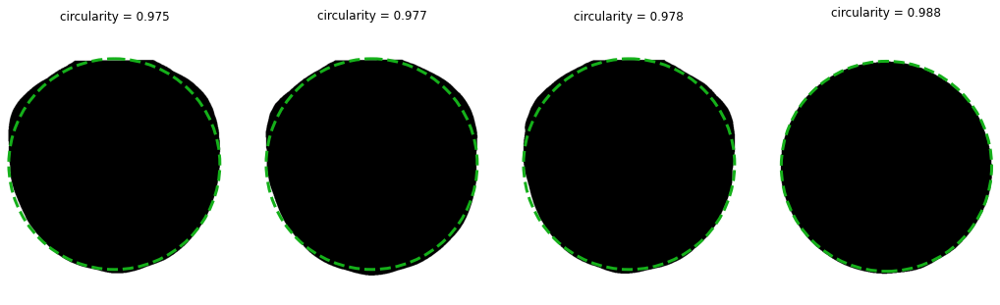

Model: C



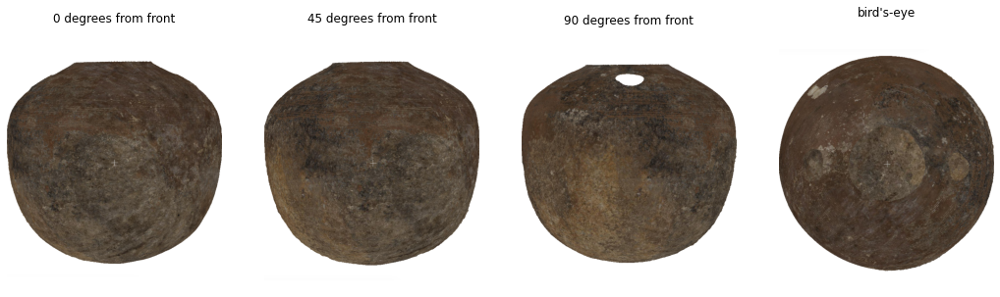

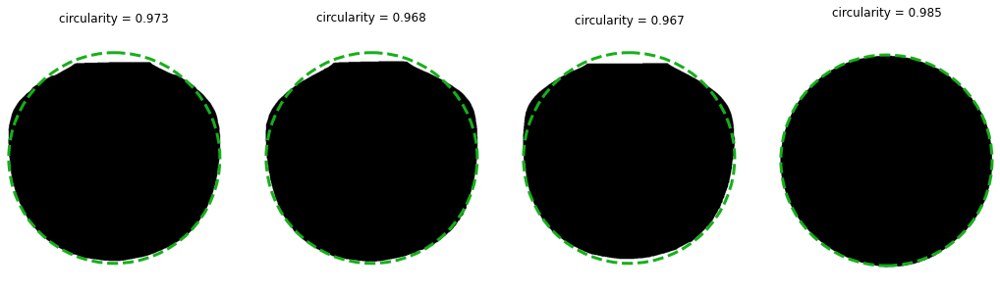

Model: D



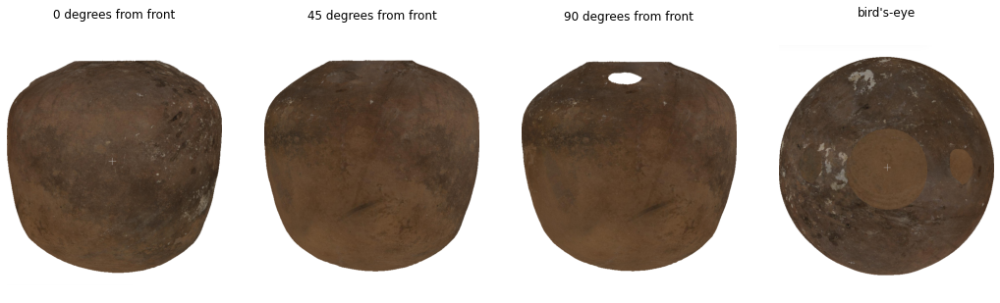

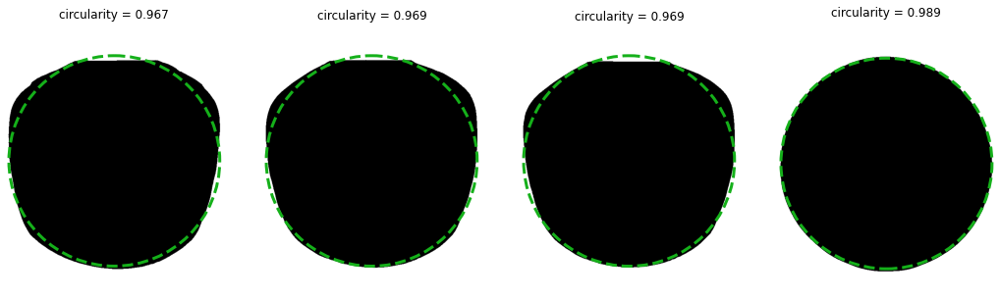

Model: F



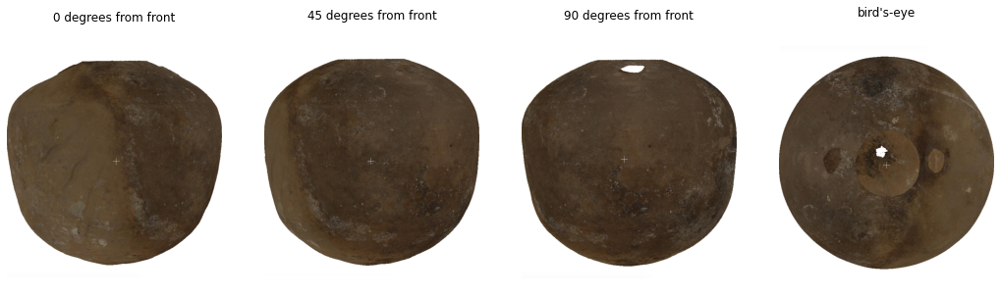

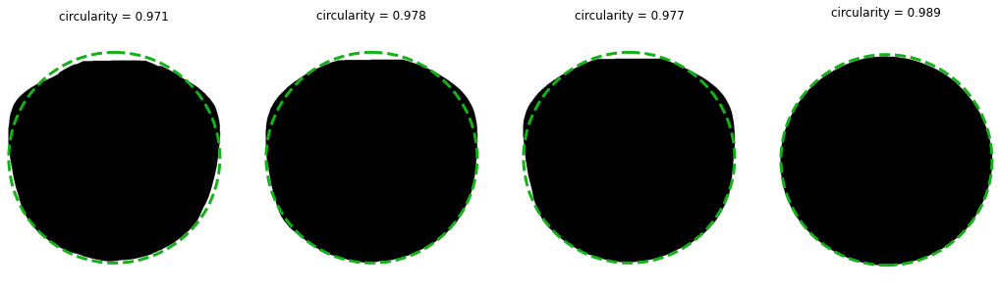

Model: UN16



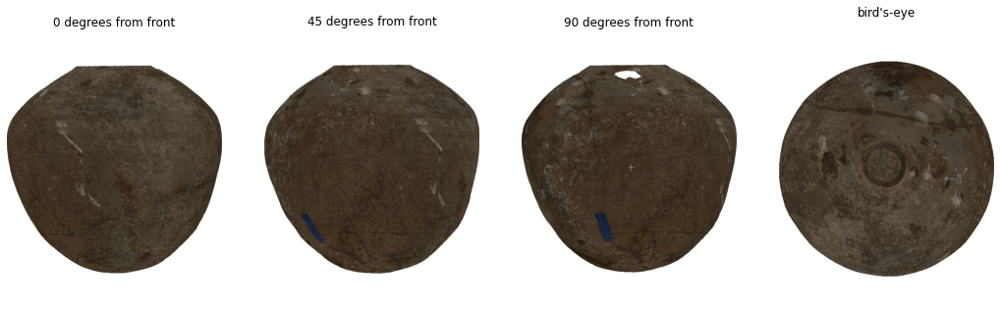

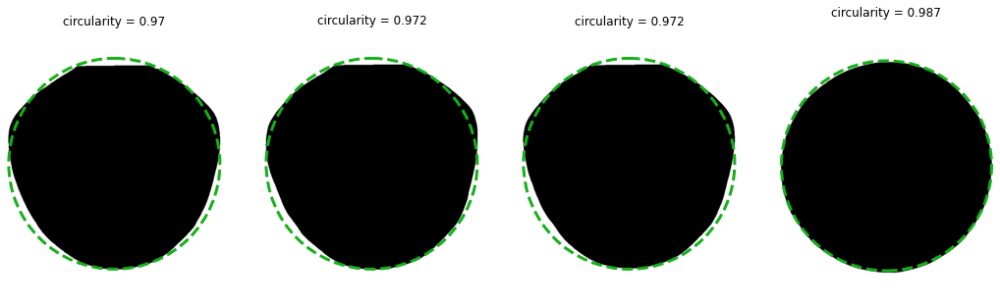

Model: W1



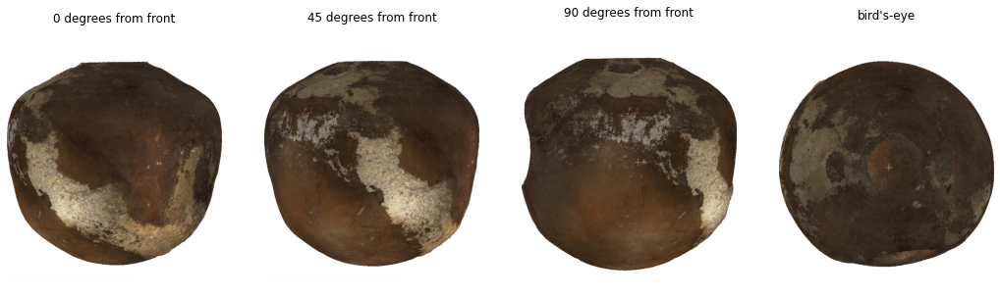

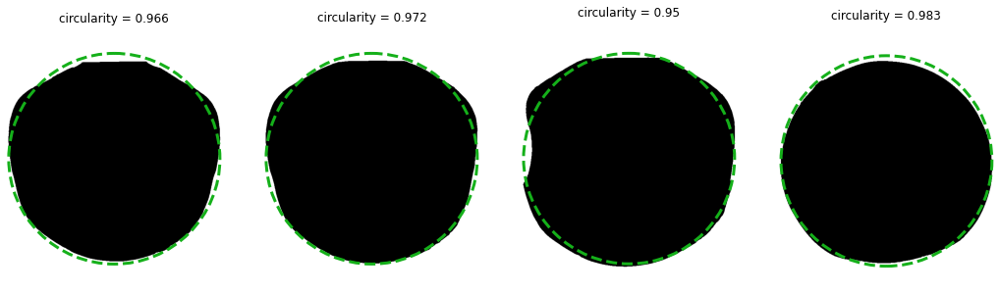

Model: W8



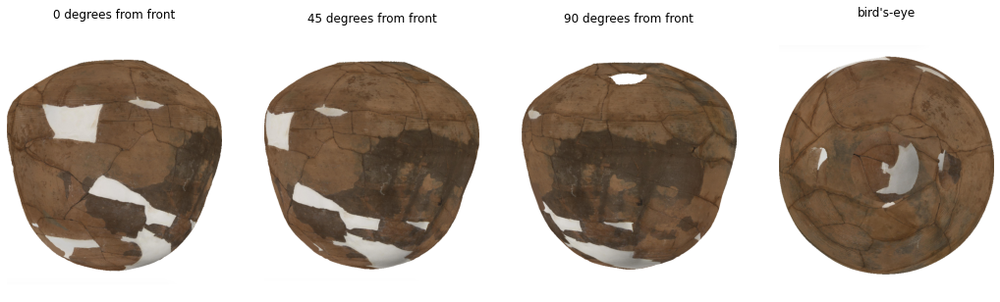

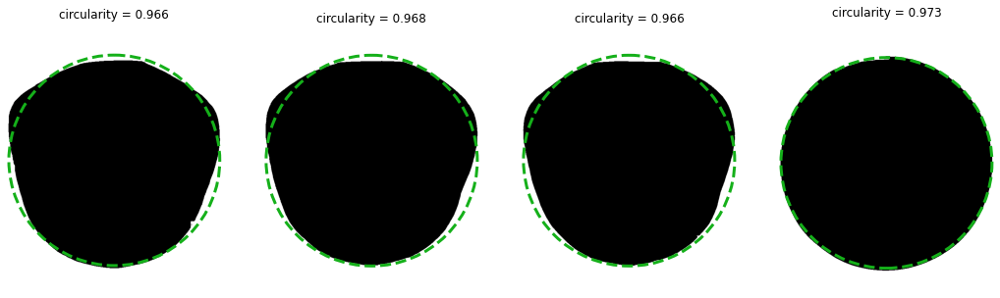

Model: W43



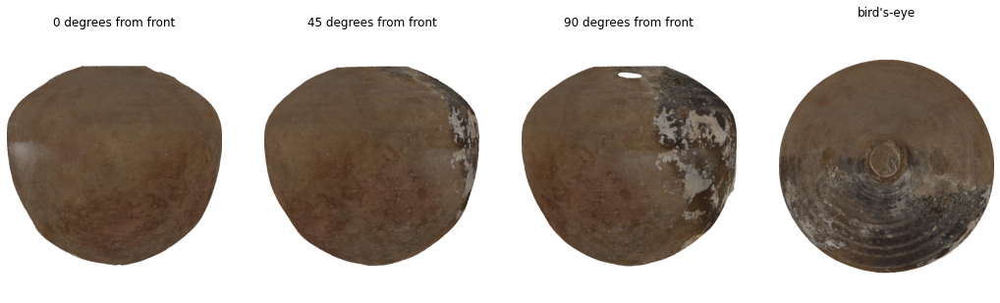

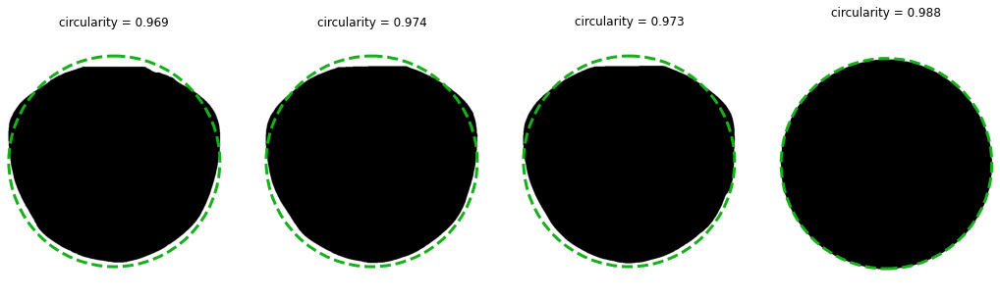

Model: W55



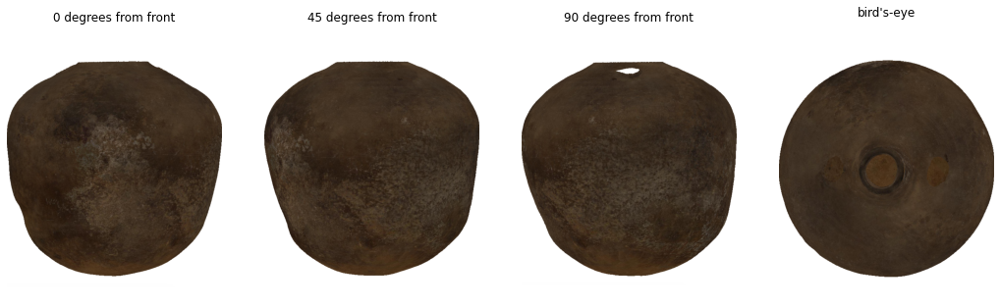

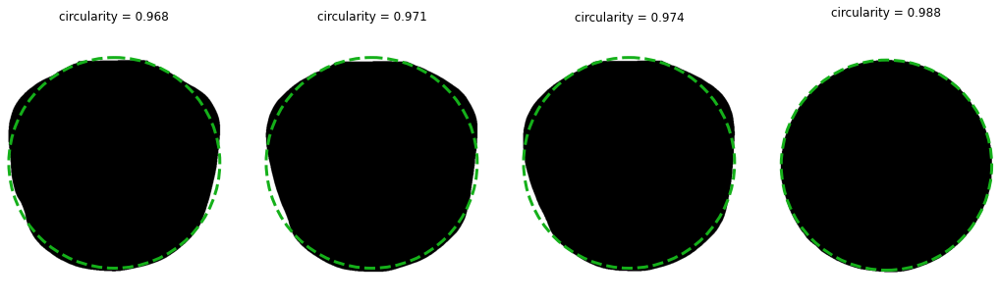

Model: W63



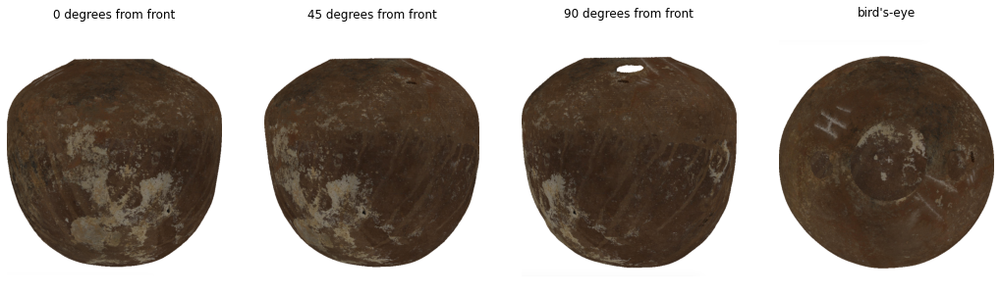

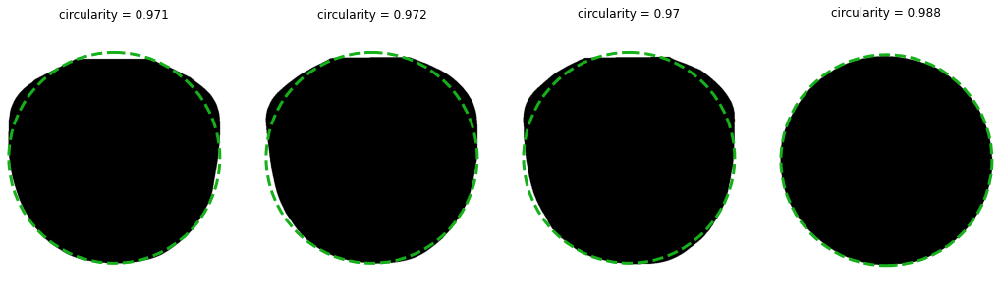

Model: W69



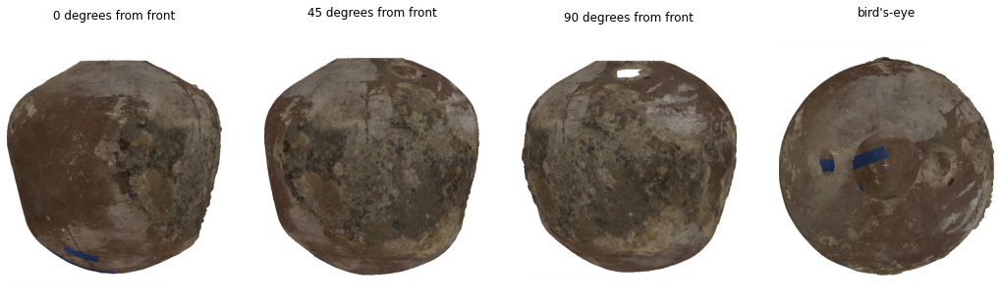

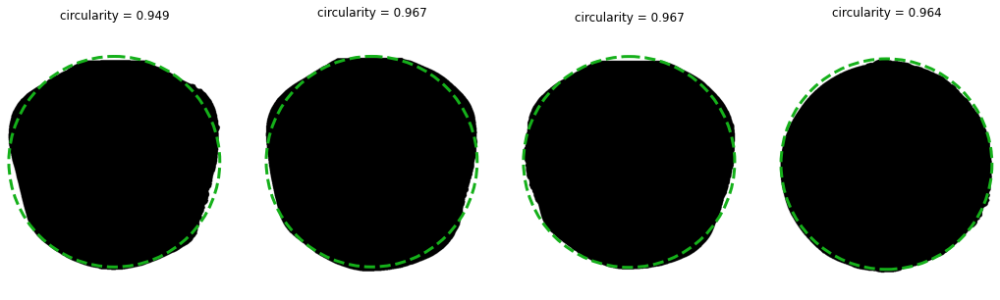

Model: W70



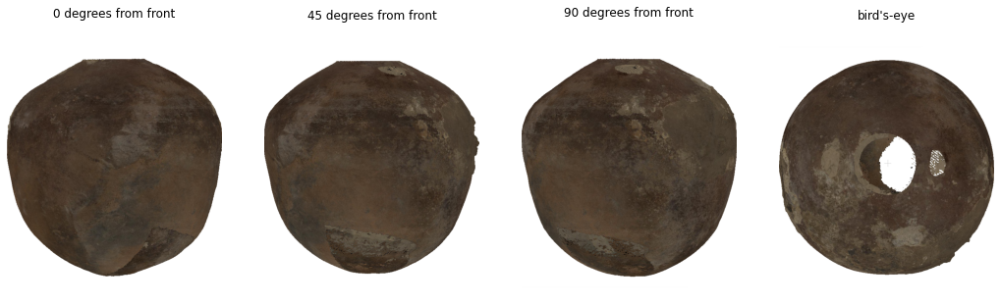

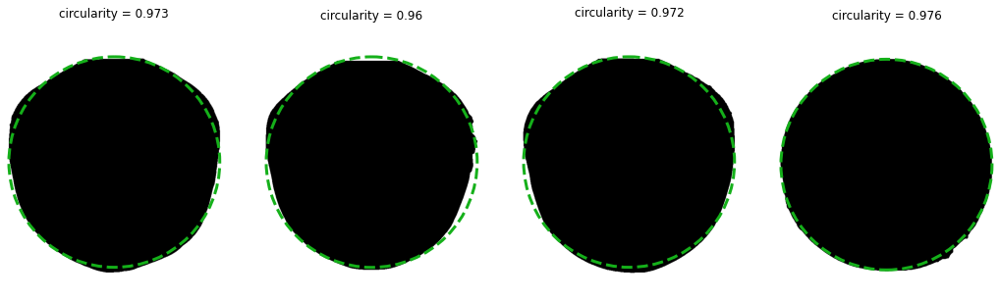

Model: W74



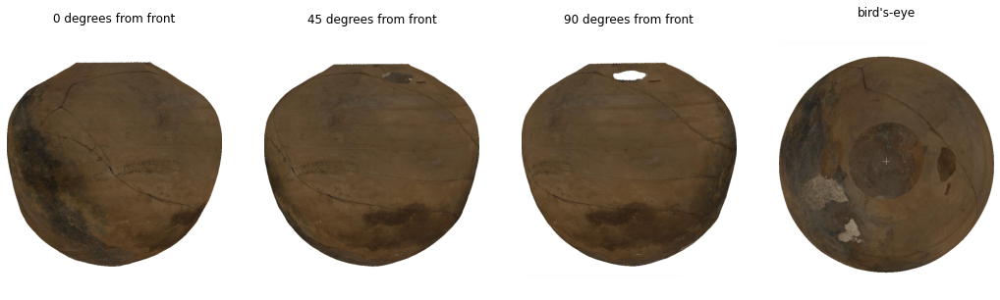

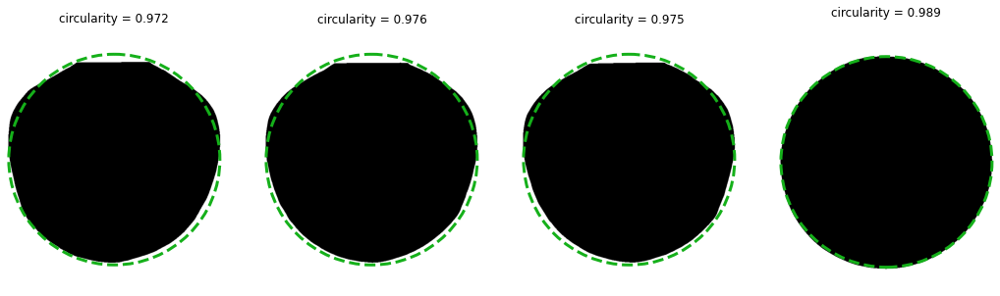

Model: W77



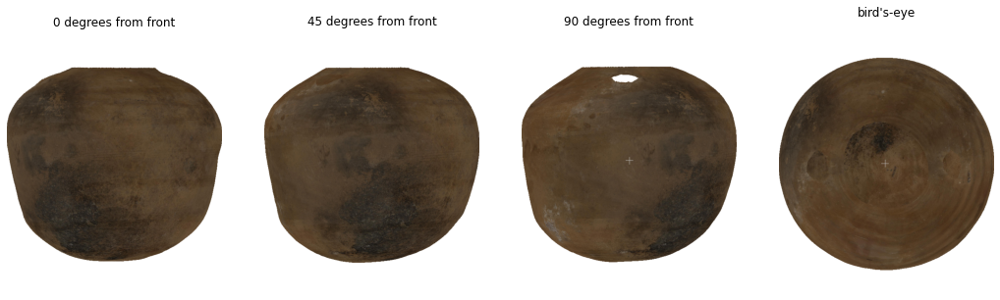

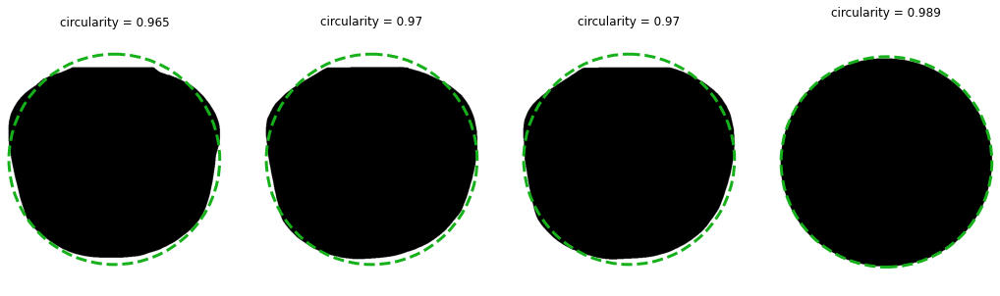

Model: X5



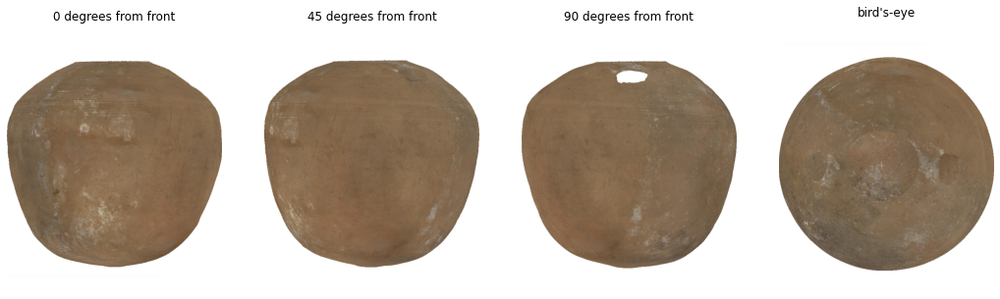

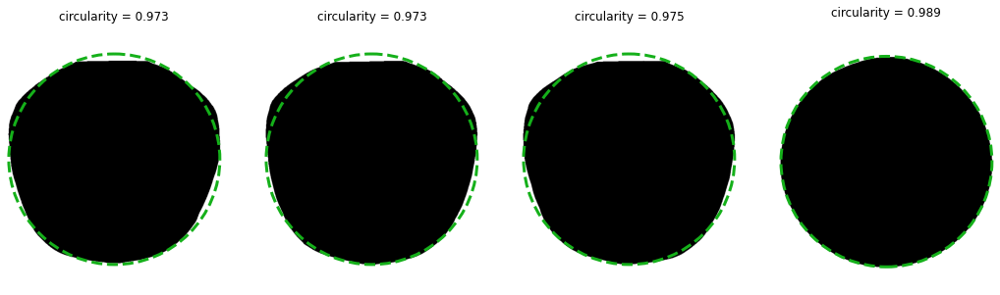

Model: X12



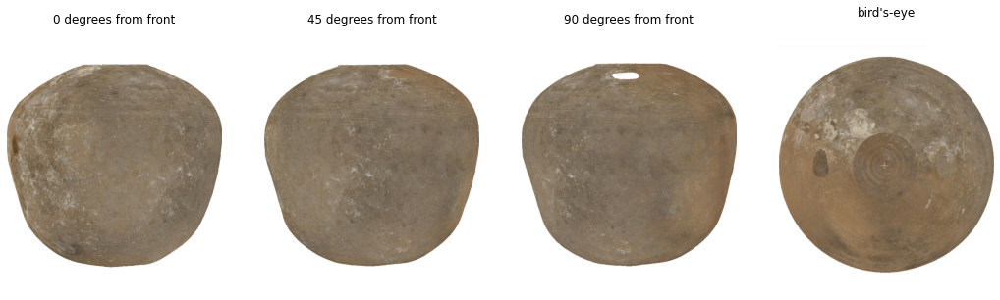

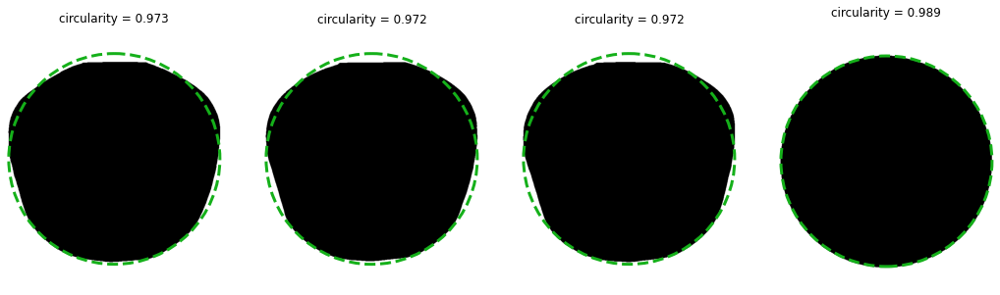

Model: Y2



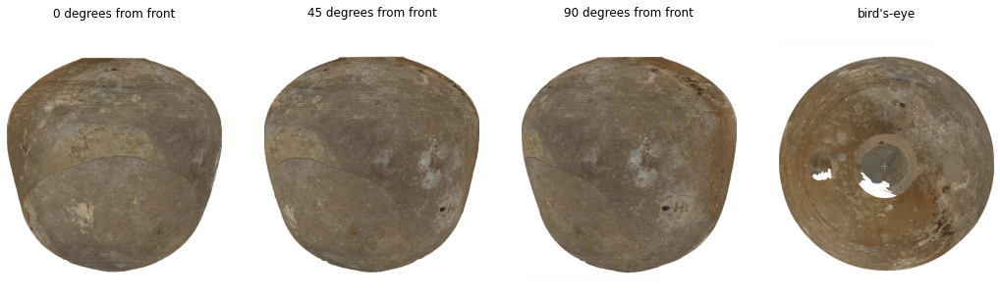

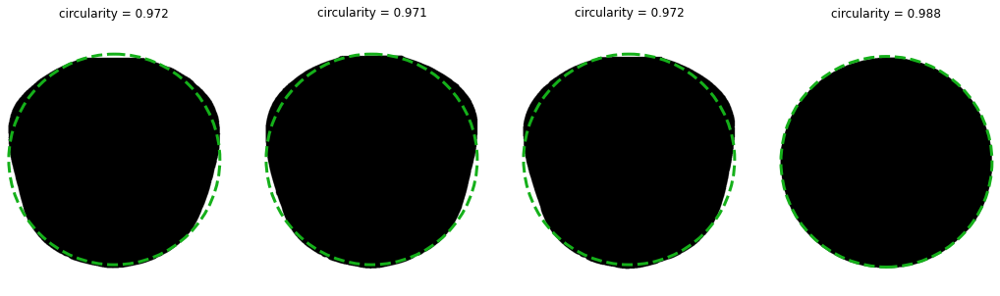

Model: Y7



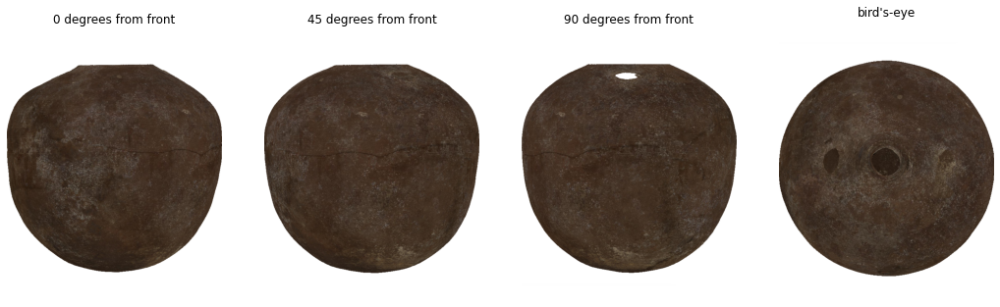

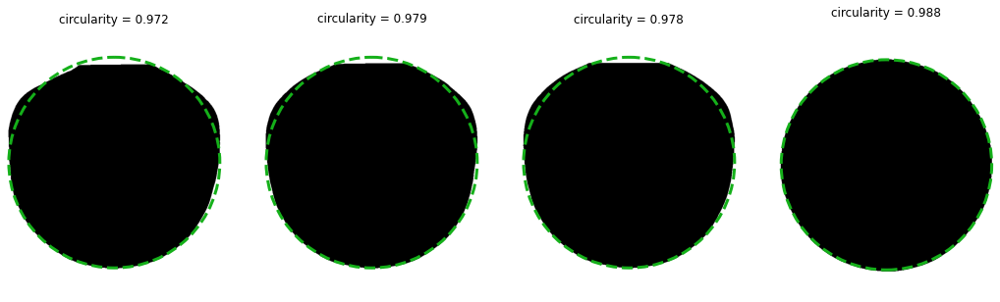

Model: Y11



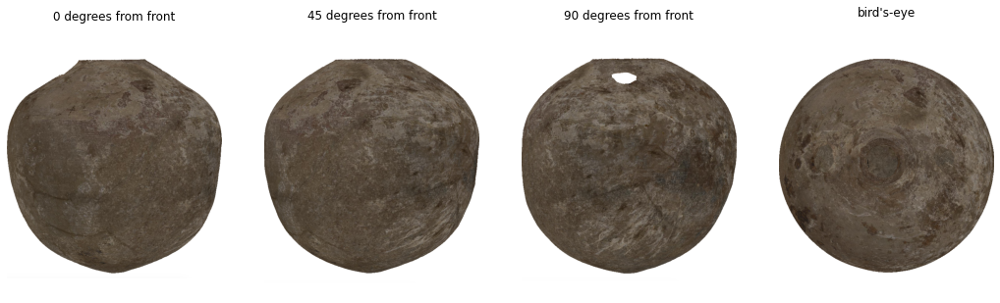

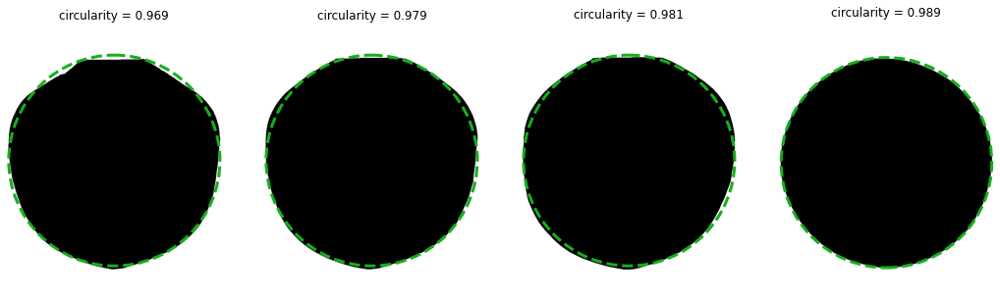

Model: Y12



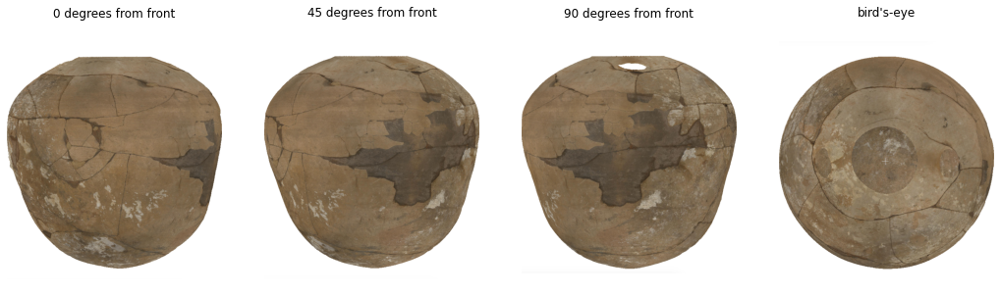

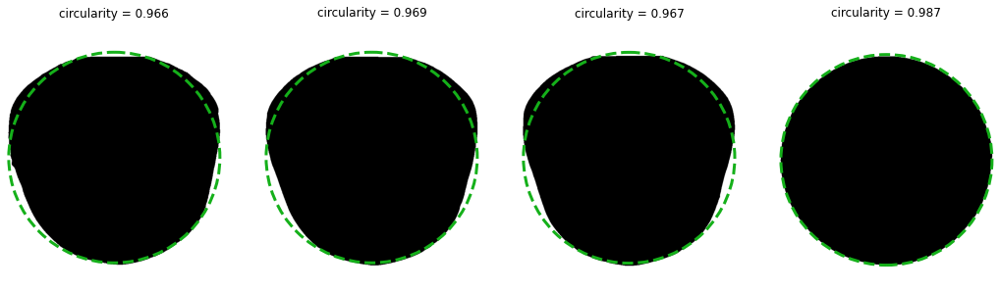

Model: Y14



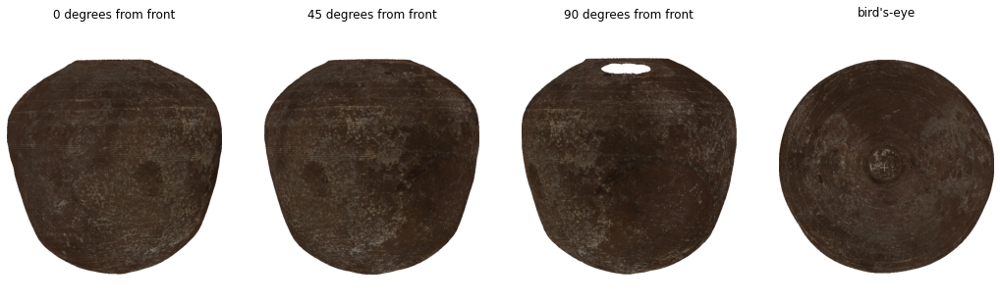

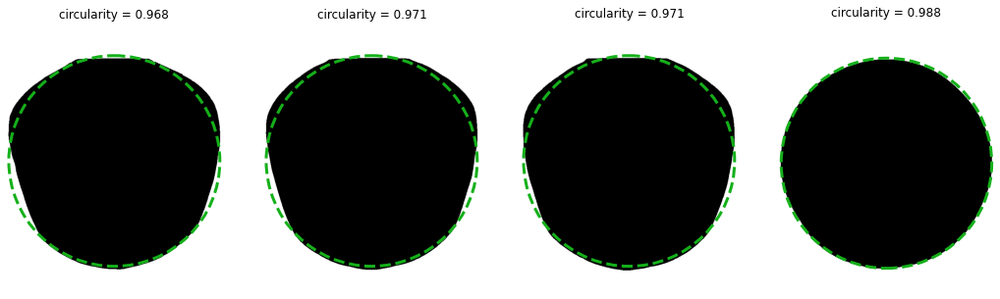

Model: Y15



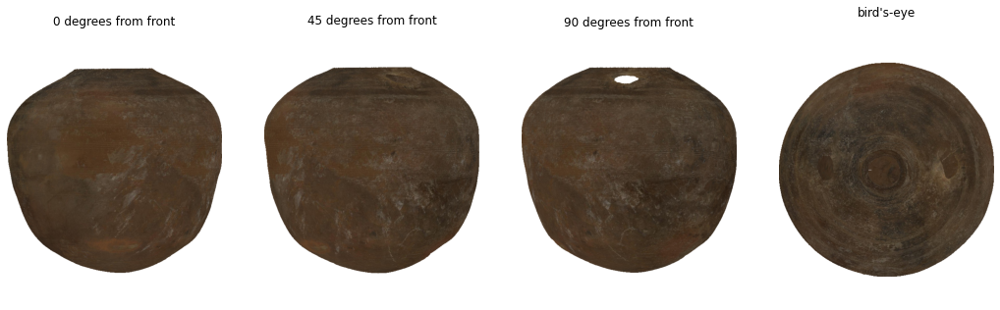

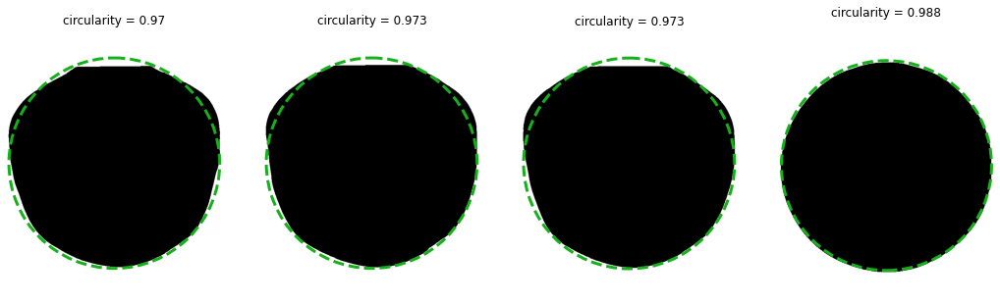

Model: Y22



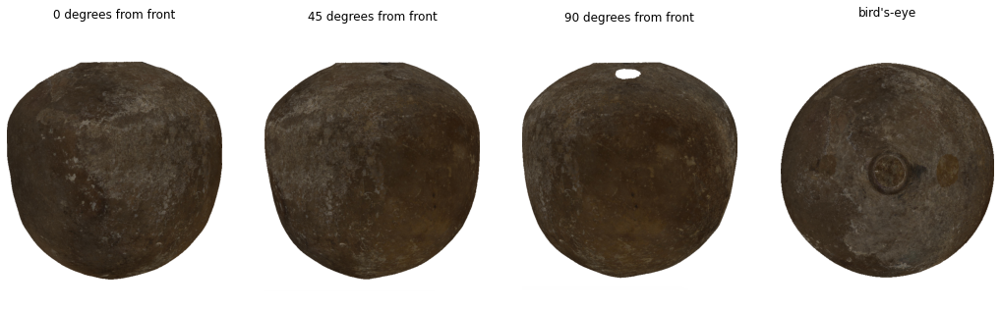

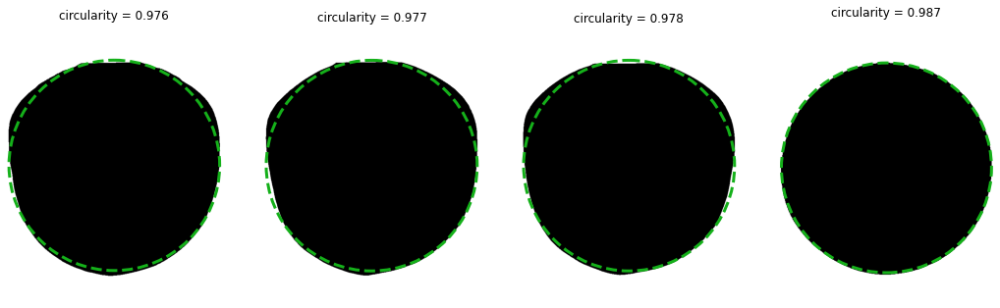

Model: Y28



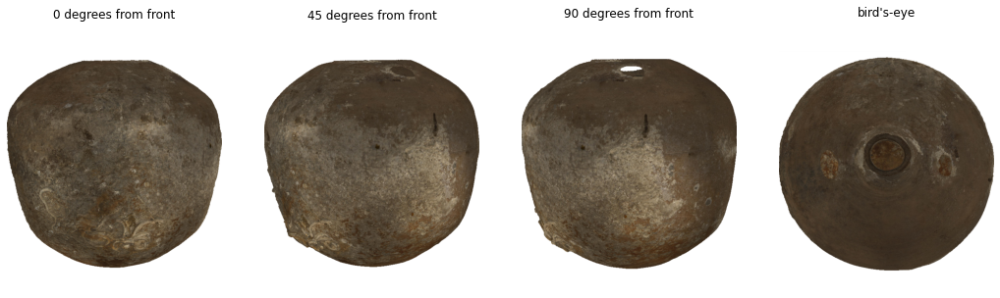

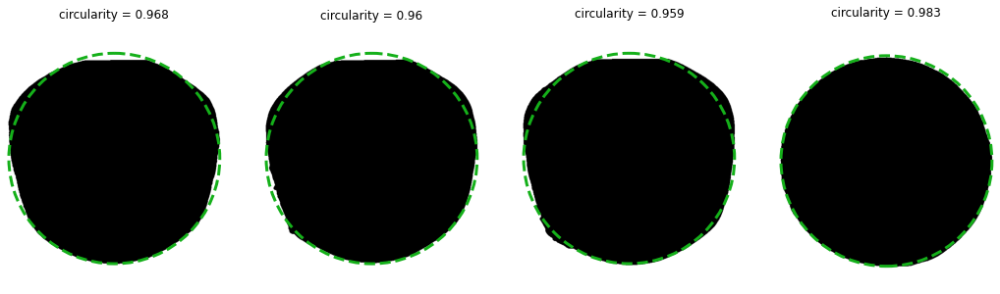

Model: Y32



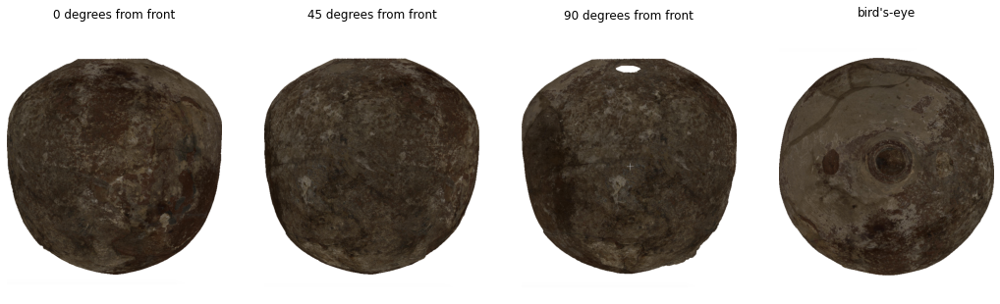

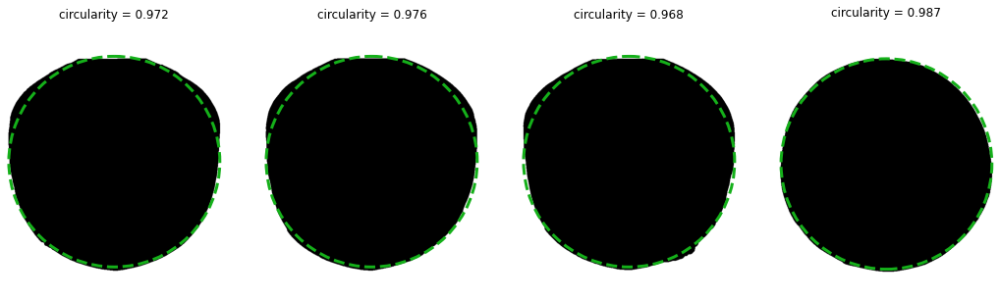

Model: Y34



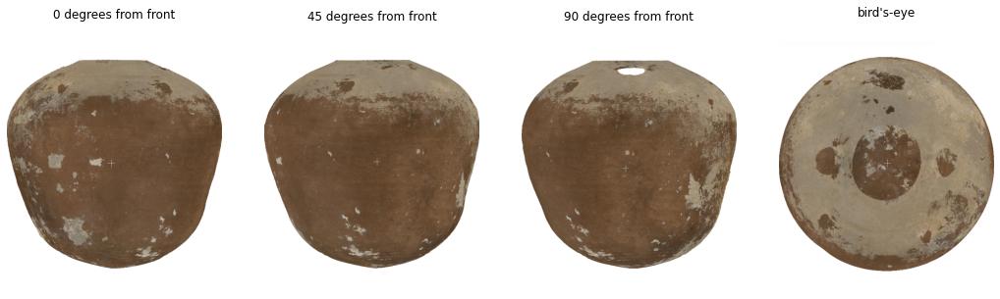

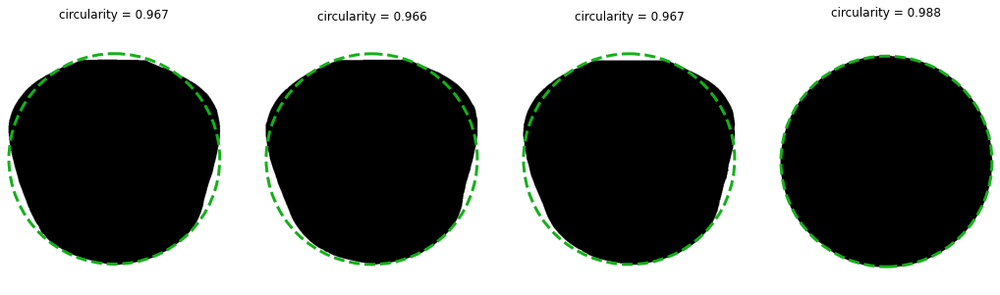

Model: Y39



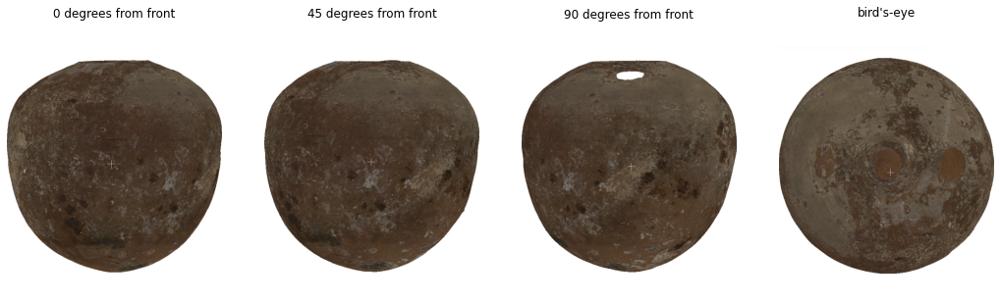

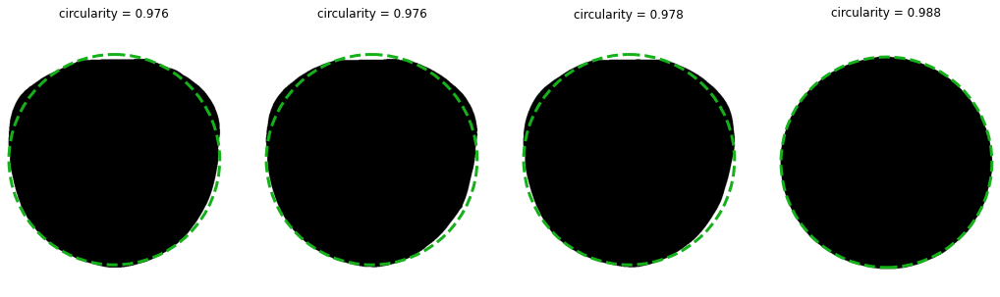

Model: Y45



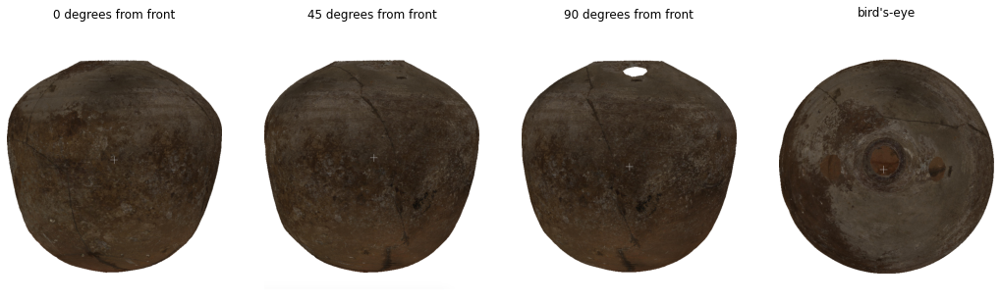

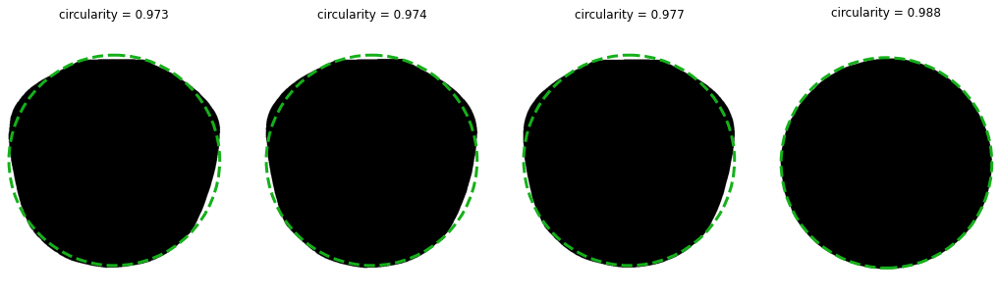

Model: Y114



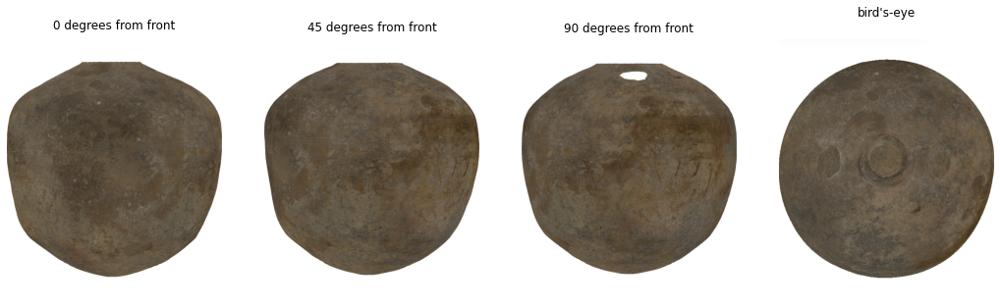

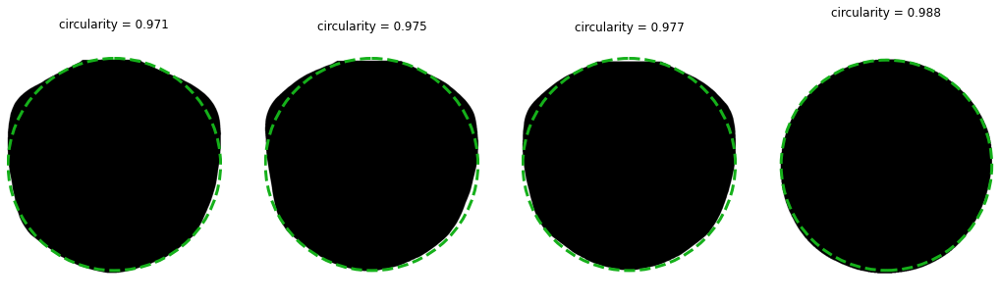

Model: Y123



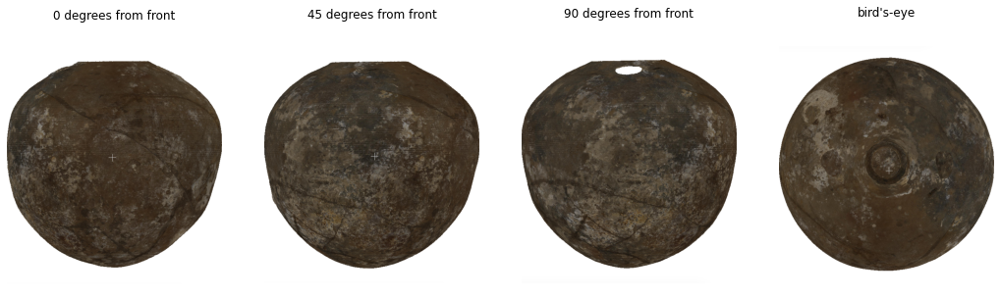

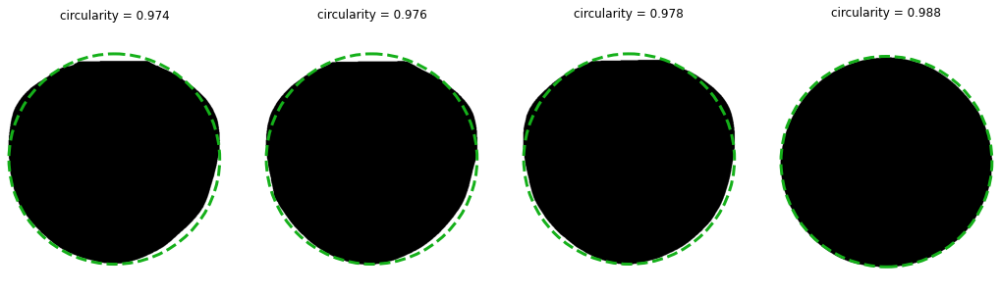

Model: Y126



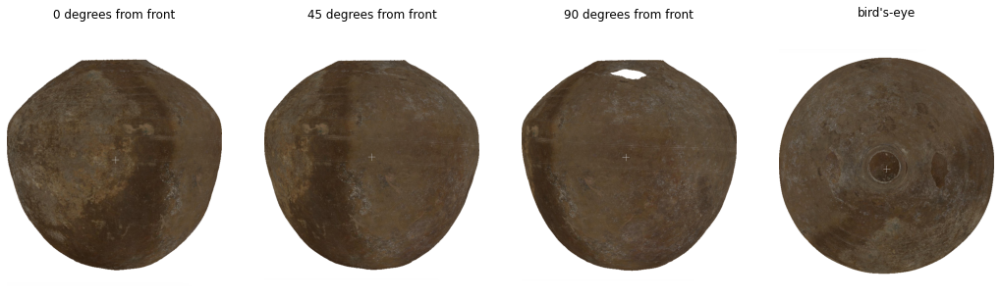

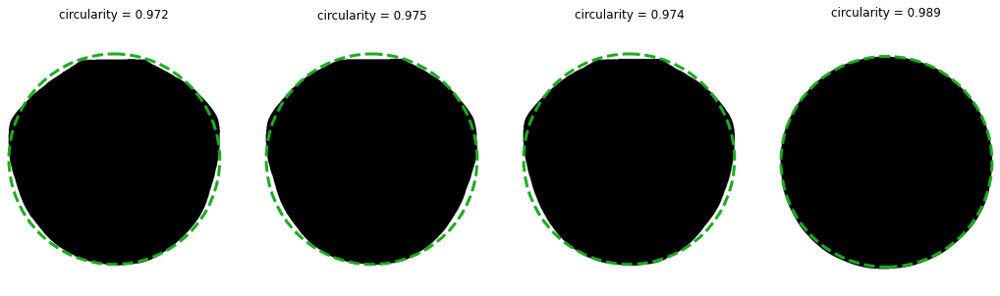

Model: Y127



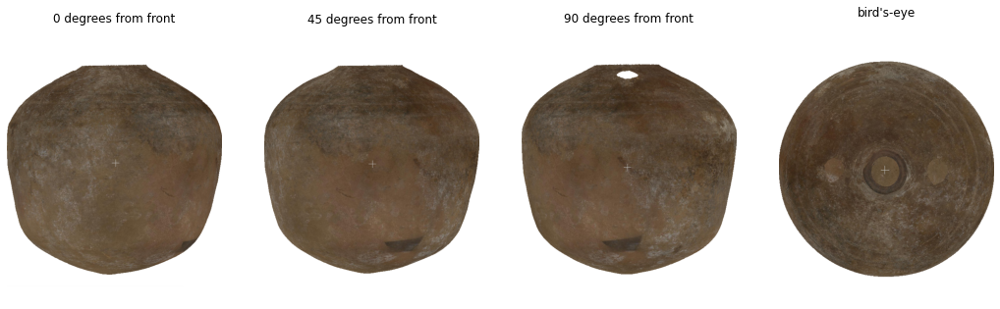

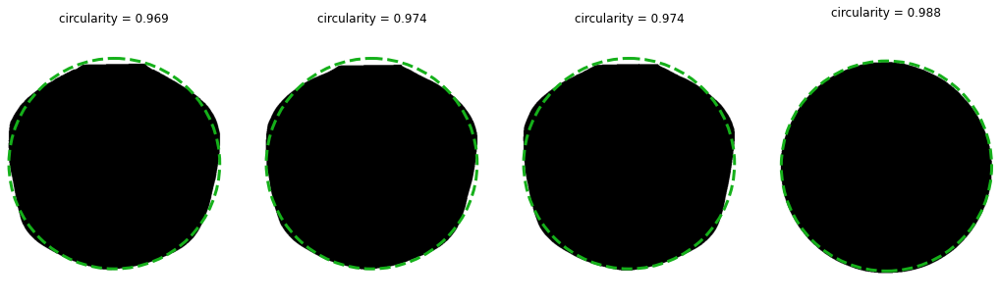

Model: Y128



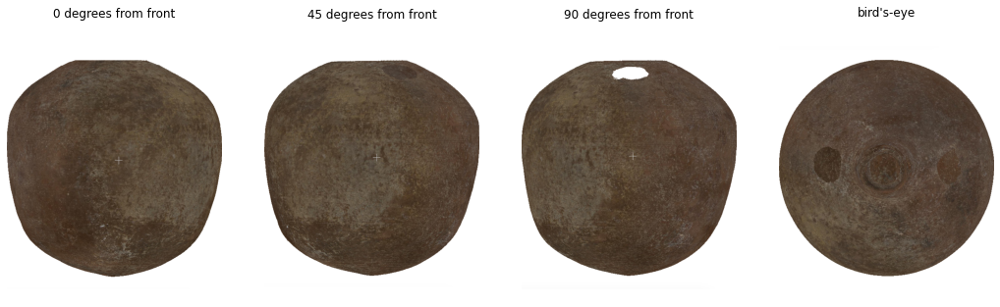

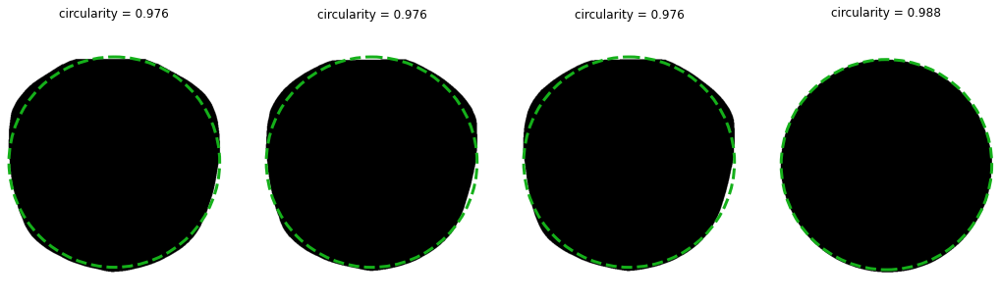

Model: Y135



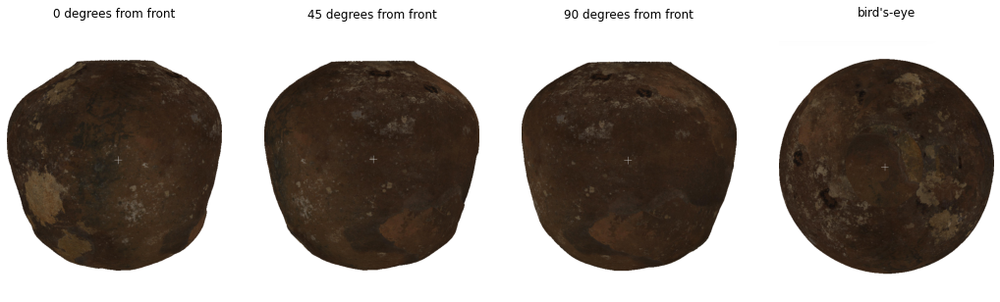

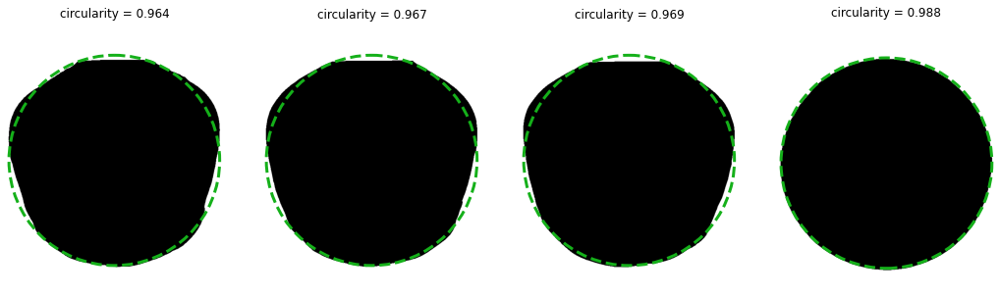

Model: Y148



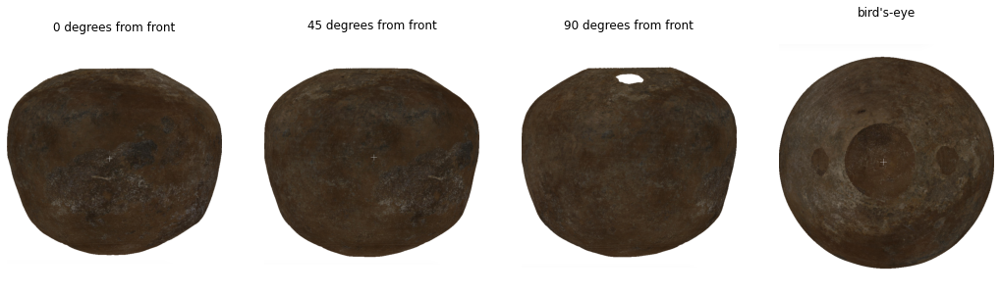

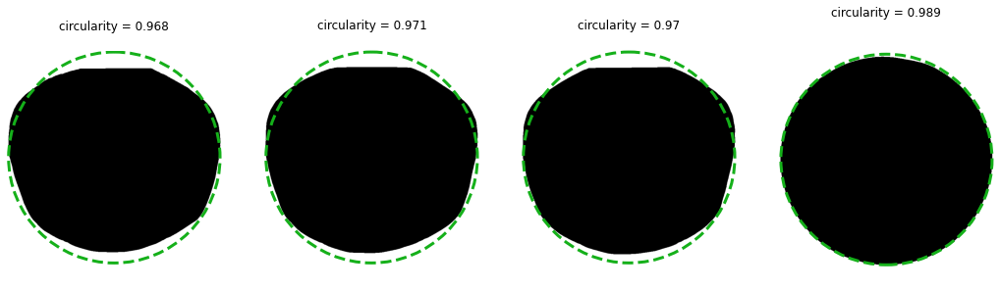

Model: Y149



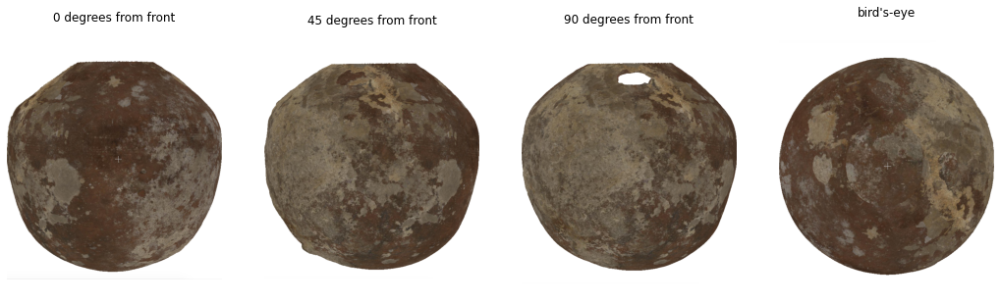

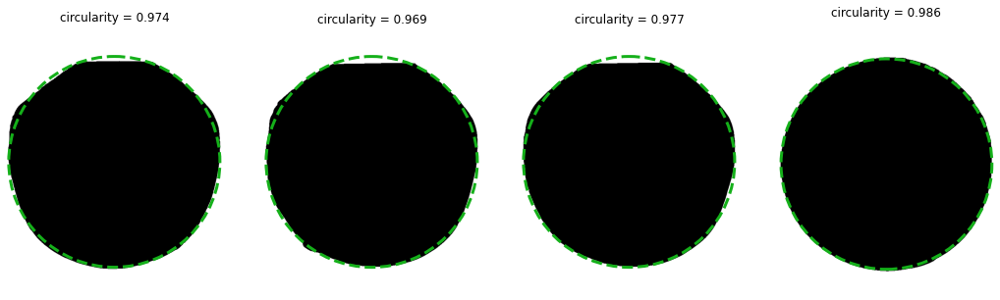

In [116]:
circularities_all = []
for model in models:
    circularities = circularity_util.run(model)
    circularities_all.append(circularities)

In [16]:
circularities_all = np.asarray(circularities_all)
circularities_0 = circularities_all[:,0]
circularities_45 = circularities_all[:,1]
circularities_90 = circularities_all[:,2]
circularities_birdseye = circularities_all[:,3]

In [17]:
df['c0'] = circularities_0
df['c45'] = circularities_45
df['c90'] = circularities_90
df['cbirdseye'] = circularities_birdseye

In [18]:
print('\nReference Table\n')
print('c0 = circularity with orientation of 0 deg. from front')
print('c45 = circularity with orientation of 45 deg. from front')
print('c90 = circularity with orientation of 90 deg. from front')
print('cbirdseye = circularity from bird\'s-eye view')

df


Reference Table

c0 = circularity with orientation of 0 deg. from front
c45 = circularity with orientation of 45 deg. from front
c90 = circularity with orientation of 90 deg. from front
cbirdseye = circularity from bird's-eye view


,model,c0,c45,c90,cbirdseye
0,83-2,0.973432,0.977965,0.975471,0.988501
1,84-1,0.975636,0.968058,0.975864,0.974436
2,84-3,0.968847,0.964384,0.977229,0.976560
3,84-10,0.975972,0.975835,0.974753,0.987619
4,86-38,0.972688,0.973826,0.971682,0.987256
5,86-75,0.975367,0.979267,0.976954,0.987115
6,86-85,0.975144,0.977202,0.979242,0.988845
7,86-90,0.974158,0.977660,0.977378,0.988909
8,86-92,0.976839,0.980453,0.979282,0.987015
9,86-93,0.974067,0.977705,0.977374,0.987948


In [20]:
df.to_csv('circularities.csv')

In [21]:
circularities_all = pd.read_csv('circularities.csv')

In [22]:
c0 = list(circularities_all.c0)
c45 = list(circularities_all.c45)
c90 = list(circularities_all.c90)
cbirdseye = list(circularities_all.cbirdseye)

# Visualize circularity distributions

In [94]:
colors = ['#009b76', '#eaab00', '#0098db', '#d2c295']

## Plots for the four orientations displayed separately

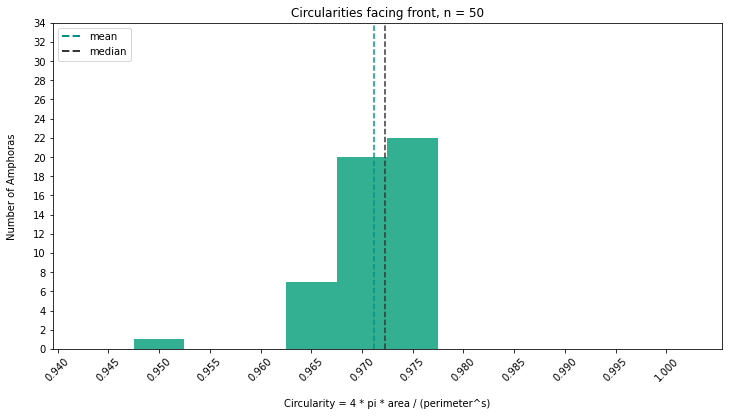

stdev = 0.00466


In [150]:
width = 0.005
plt.figure(figsize=(12, 6))

plt.axvline(np.median(c0), color='xkcd:dark gray', ls='--')
median_line = Line2D([0], [0], color='xkcd:dark gray', linewidth=2, ls='--')
plt.axvline(np.mean(c0), color='xkcd:teal', ls='--')
mean_line = Line2D([0], [0], color='xkcd:teal', linewidth=2, ls='--')
plt.legend([mean_line, median_line], ['mean', 'median'], loc='upper left')

plt.title('Circularities facing front, n = %s' % len(c0))
plt.hist(c0, bins=np.arange(0.94, 1, width)+width/2, color=colors[0], alpha=0.8)
plt.xticks(np.arange(0.94, 1, width), rotation=45)
plt.yticks(np.arange(0, 35, 2))
plt.xlabel('\nCircularity = 4 * pi * area / (perimeter^s)')
plt.ylabel('Number of Amphoras\n')
plt.show()

print('stdev = %s' % round(np.std(c0), 5))

Note: The outlier at ~0.95 is W8, where concretions cause a jagged edge that increases perimeter substantially without increasing area substantially

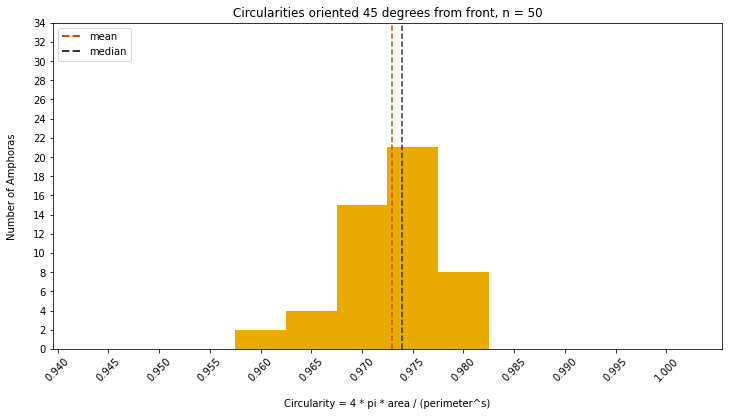

stdev = 0.00468


In [151]:
width = 0.005
plt.figure(figsize=(12, 6))

plt.axvline(np.median(c45), color='xkcd:dark gray', ls='--')
median_line = Line2D([0], [0], color='xkcd:dark gray', linewidth=2, ls='--')
plt.axvline(np.mean(c45), color='xkcd:dark orange', ls='--')
mean_line = Line2D([0], [0], color='xkcd:dark orange', linewidth=2, ls='--')
plt.legend([mean_line, median_line], ['mean', 'median'], loc='upper left')

plt.title('Circularities oriented 45 degrees from front, n = %s' % len(c45))
plt.hist(c45, bins=np.arange(0.94, 1, width)+width/2, color=colors[1])
plt.xticks(np.arange(0.94, 1, width), rotation=45)
plt.yticks(np.arange(0, 35, 2))
plt.xlabel('\nCircularity = 4 * pi * area / (perimeter^s)')
plt.ylabel('Number of Amphoras\n')
plt.show()

print('stdev = %s' % round(np.std(c45), 5))

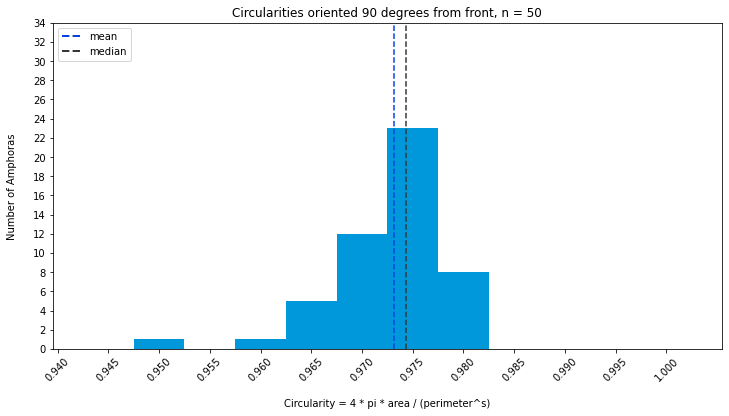

stdev = 0.00541


In [152]:
width = 0.005
plt.figure(figsize=(12, 6))

plt.axvline(np.median(c90), color='xkcd:dark gray', ls='--')
median_line = Line2D([0], [0], color='xkcd:dark gray', linewidth=2, ls='--')
plt.axvline(np.mean(c90), color='xkcd:blue', ls='--')
mean_line = Line2D([0], [0], color='xkcd:blue', linewidth=2, ls='--')
plt.legend([mean_line, median_line], ['mean', 'median'], loc='upper left')

plt.title('Circularities oriented 90 degrees from front, n = %s' % len(c90))
plt.hist(c90, bins=np.arange(0.94, 1, width)+width/2, color=colors[2])
plt.xticks(np.arange(0.94, 1, width), rotation=45)
plt.yticks(np.arange(0, 35, 2))
plt.xlabel('\nCircularity = 4 * pi * area / (perimeter^s)')
plt.ylabel('Number of Amphoras\n')
plt.show()

print('stdev = %s' % round(np.std(c90), 5))

Note: The outlier at ~0.95 is W1, which has a big chunk missing out of its body.

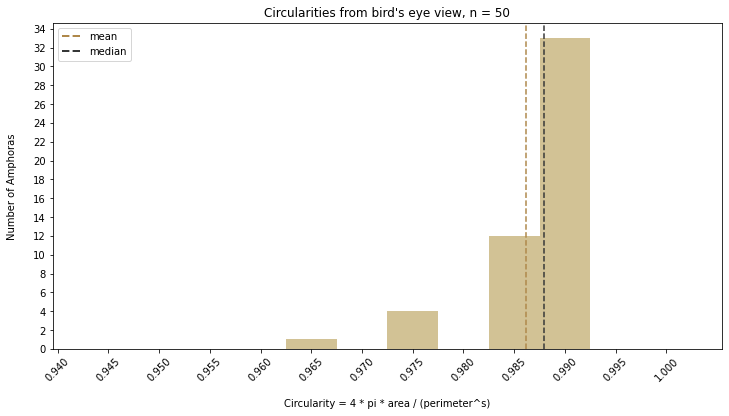

stdev = 0.00487


In [153]:
width = 0.005
plt.figure(figsize=(12, 6))

plt.axvline(np.median(cbirdseye), color='xkcd:dark gray', ls='--')
median_line = Line2D([0], [0], color='xkcd:dark gray', linewidth=2, ls='--')
plt.axvline(np.mean(cbirdseye), color='xkcd:dark tan', ls='--')
mean_line = Line2D([0], [0], color='xkcd:dark tan', linewidth=2, ls='--')
plt.legend([mean_line, median_line], ['mean', 'median'], loc='upper left')

plt.title('Circularities from bird\'s eye view, n = %s' % len(c90))
plt.hist(cbirdseye, bins=np.arange(0.94, 1, width)+width/2, color=colors[3])
plt.xticks(np.arange(0.94, 1, width), rotation=45)
plt.yticks(np.arange(0, 35, 2))
plt.xlabel('\nCircularity = 4 * pi * area / (perimeter^s)')
plt.ylabel('Number of Amphoras\n')
plt.show()

print('stdev = %s' % round(np.std(cbirdseye), 5))

Note: The outlier at ~0.965 is W69 and the outlier at ~0.975 is W70; these jars have a lot of concretions which cause a jagged edge that increases perimeter substantially without increasing area substantially.

## Superimposing the plots for the four orientations

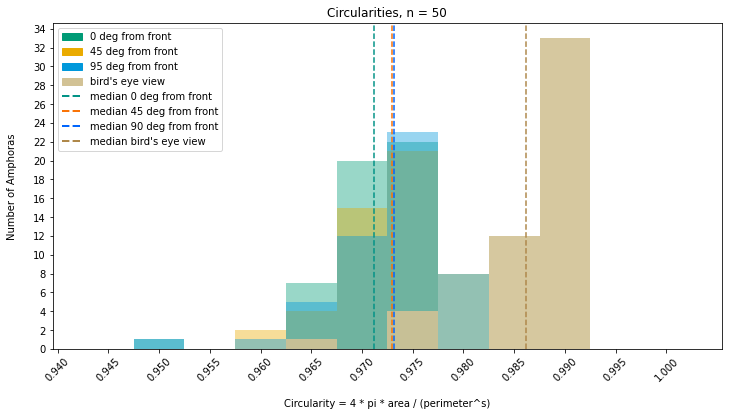

In [159]:
width = 0.005
plt.figure(figsize=(12, 6))
plt.title('Circularities, n = %s' % len(c90))
plt.hist(c0, bins=np.arange(0.94, 1, width)+width/2, alpha=0.4, color=colors[0], label=str)
plt.hist(c45, bins=np.arange(0.94, 1, width)+width/2, alpha=0.4, color=colors[1], label=str)
plt.hist(c90, bins=np.arange(0.94, 1, width)+width/2, alpha=0.4, color=colors[2], label=str)
plt.hist(cbirdseye, bins=np.arange(0.94, 1, width)+width/2, alpha=0.9, color=colors[3], label=str)

plt.axvline(np.mean(c0), color='xkcd:teal', ls='--')
plt.axvline(np.mean(c45), color='xkcd:orange', ls='--')
plt.axvline(np.mean(c90), color='xkcd:bright blue', ls='--')
plt.axvline(np.mean(cbirdseye), color='xkcd:dark tan', ls='--')

p0 = mpatches.Patch(color=colors[0], label='0 deg from front')
p45 = mpatches.Patch(color=colors[1], label='45 deg from front')
p90 = mpatches.Patch(color=colors[2], label='95 deg from front')
pbirdseye = mpatches.Patch(color=colors[3], label='bird\'s eye view')
med0 = Line2D([0], [0], color='xkcd:teal', linewidth=2, ls='--', label='median 0 deg from front')
med45 = Line2D([0], [0], color='xkcd:orange', linewidth=2, ls='--', label='median 45 deg from front')
med90 = Line2D([0], [0], color='xkcd:bright blue', linewidth=2, ls='--', label='median 90 deg from front')
medbe = Line2D([0], [0], color='xkcd:dark tan', linewidth=2, ls='--', label='median bird\'s eye view')
plt.legend(handles=[p0, p45, p90, pbirdseye, med0, med45, med90, medbe], loc='upper left')

plt.xticks(np.arange(0.94, 1, width), rotation=45)
plt.yticks(np.arange(0, 35, 2))
plt.xlabel('\nCircularity = 4 * pi * area / (perimeter^s)')
plt.ylabel('Number of Amphoras\n')
plt.show()

# Stacking the plots for the four orientations

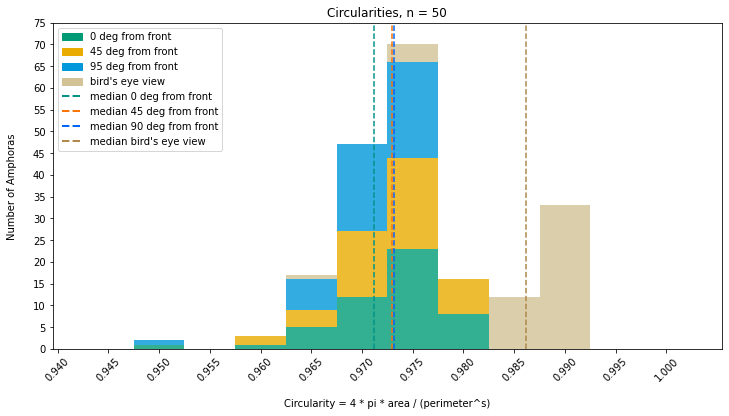

In [160]:
width = 0.005
plt.figure(figsize=(12, 6))
plt.title('Circularities, n = %s' % len(c90))
plt.hist([c90, c45, c0, cbirdseye], bins=np.arange(0.94, 1, width)+width/2, color=colors, alpha=0.8, stacked=True)

plt.axvline(np.mean(c0), color='xkcd:teal', ls='--')
plt.axvline(np.mean(c45), color='xkcd:orange', ls='--')
plt.axvline(np.mean(c90), color='xkcd:bright blue', ls='--')
plt.axvline(np.mean(cbirdseye), color='xkcd:dark tan', ls='--')

p0 = mpatches.Patch(color=colors[0], label='0 deg from front')
p45 = mpatches.Patch(color=colors[1], label='45 deg from front')
p90 = mpatches.Patch(color=colors[2], label='95 deg from front')
pbirdseye = mpatches.Patch(color=colors[3], label='bird\'s eye view')
med0 = Line2D([0], [0], color='xkcd:teal', linewidth=2, ls='--', label='median 0 deg from front')
med45 = Line2D([0], [0], color='xkcd:orange', linewidth=2, ls='--', label='median 45 deg from front')
med90 = Line2D([0], [0], color='xkcd:bright blue', linewidth=2, ls='--', label='median 90 deg from front')
medbe = Line2D([0], [0], color='xkcd:dark tan', linewidth=2, ls='--', label='median bird\'s eye view')
plt.legend(handles=[p0, p45, p90, pbirdseye, med0, med45, med90, medbe], loc='upper left')

plt.xticks(np.arange(0.94, 1, width), rotation=45)
plt.yticks(np.arange(0, 80, 5))
plt.xlabel('\nCircularity = 4 * pi * area / (perimeter^s)')
plt.ylabel('Number of Amphoras\n')
plt.show()

# Discussion of Results

As expected, the amphoras in this dataset are very close to ideal circles from a bird's-eye view. The amphoras in this dataset are also very close to ideal circles when viewed 0, 45, and 90 degrees from the front.

From the four plots where the orientations are displayed separately, we can make some observations about the individual distributions:

- For all vertical orientations ({0, 45, 90} degrees from front):
    - Mean and median circularity are quite close. This indicates that the distribution of circularity measurements is fairly symmetrical, with a little bit of a left skew (due to jars that are lower in circularity because they are missing fragments or due to concretions).
    - stdev(circularity) facing front < stdev(circularity) facing 45 deg from front < stdev(circularity) facing 90 deg from front. This suggests that circularity facing front is most reliable, and circularity facing the handle attachment area is least reliable.
- For the bird's eye view orientation, the mean is a little bit further from median circularity, so there is a little more left skew (again due to jars that are lower in circularity because they are missing fragments or due to concretions).

From the two plots where the orientations are displayed together (superimposed and stacked), we came make some observations about the distributions comparatively:

- Circularities for the vertical orientations ({0, 45, 90} degrees from front) are close to each other.
- Circularities for the bird's eye view orientation are closer to ideal.

# Other Observations

Circularity measurements are affected when parts of the jar are missing.

- Jars for which I filled in the edges:
86-38 90 deg (missing a very small amount, confidently able to find the correct curve)

- Jars for which I did not fill in the edges:
W1 90 deg (missing too much to confidently be able to find the correct curve)

Circularity measurements are also affected by the presence of concretions, which make the edge rough and increase perimeter substantially without increasing area substantially.